In [ ]:
###### %matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [10]:
import pandas as pd
from pandas import DataFrame as df
import numpy as np
from astropy import cosmology
import matplotlib.pyplot as plt
import getdist as gd
from getdist import MCSamples
import getdist.plots as gdplot
import matplotlib
from scipy.stats import norm
import matplotlib.mlab as mlab
from autogalaxy.util import cosmology_util
from collections import Counter

cosmo = cosmology.FlatLambdaCDM(H0=70, Om0=0.3)
fig_path = '/Users/dgmt59/Documents/Plots/full_sample/sie_analysis/'

In [11]:
from autoconf import conf
import autofit as af
import autolens as al
import autolens.plot as aplt


%matplotlib inline
plt.style.use({'figure.facecolor':'white'})

workspace_path = "/Users/dgmt59/PycharmProjects/autolens_slacs/"
output_path = "/Users/dgmt59/output"
aggregator_results_path_1 = output_path + "/slacs_shu_bspline_without_shear/"



agg = af.Aggregator(directory=str(aggregator_results_path_1), completed_only=True)

Aggregator loading phases... could take some time.

 A total of 552 phases and results were found.


In [12]:

agg_sie = agg.filter(agg.directory.contains("phase[4]_mass[total]_source[fixed]/settings"))
agg_sie_2 = agg.filter(agg.directory.contains("phase[1]_mass[total]_source/settings"),
                        agg.directory.contains("mass[total__sie__no_shear]"))
agg_sie_cap = agg.filter(agg.directory.contains("phase[1]_mass[total]_source/stochastic"),
                        agg.directory.contains("mass[total__sie__no_shear]"))


print("Total Outputs = ", len(agg_sie), len(agg_sie_cap))

Filter found a total of 43 results
Filter found a total of 43 results
Filter found a total of 42 results
Total Outputs =  43 42


In [14]:
names_all = [data.name for data in agg_sie.values("dataset")]
names_no_shear_cap = [data.name for data in agg_sie_cap.values("dataset")]

print(list((Counter(names_all) - Counter(names_no_shear_cap)).elements()))

['slacs1205+4910']


slacs0008-0004


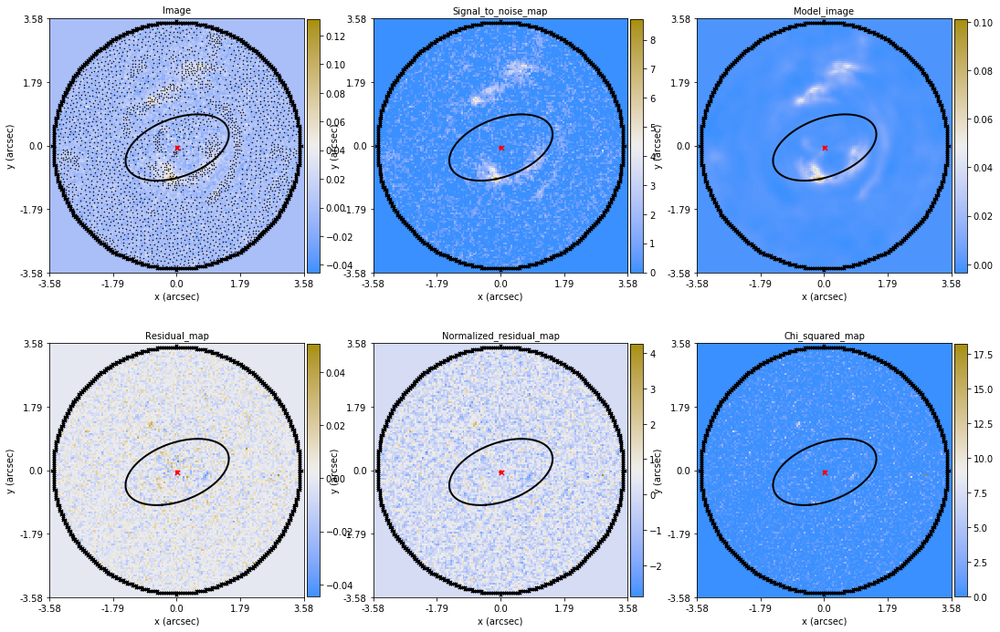

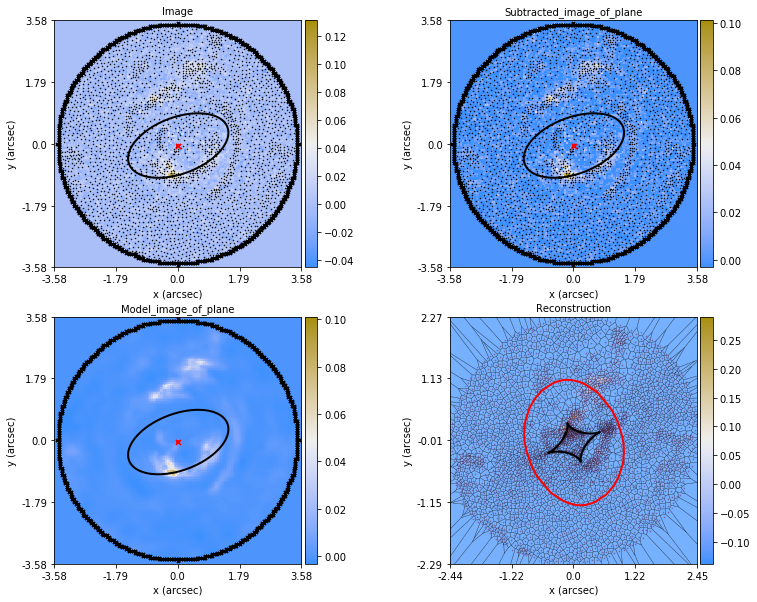

slacs1213+6708


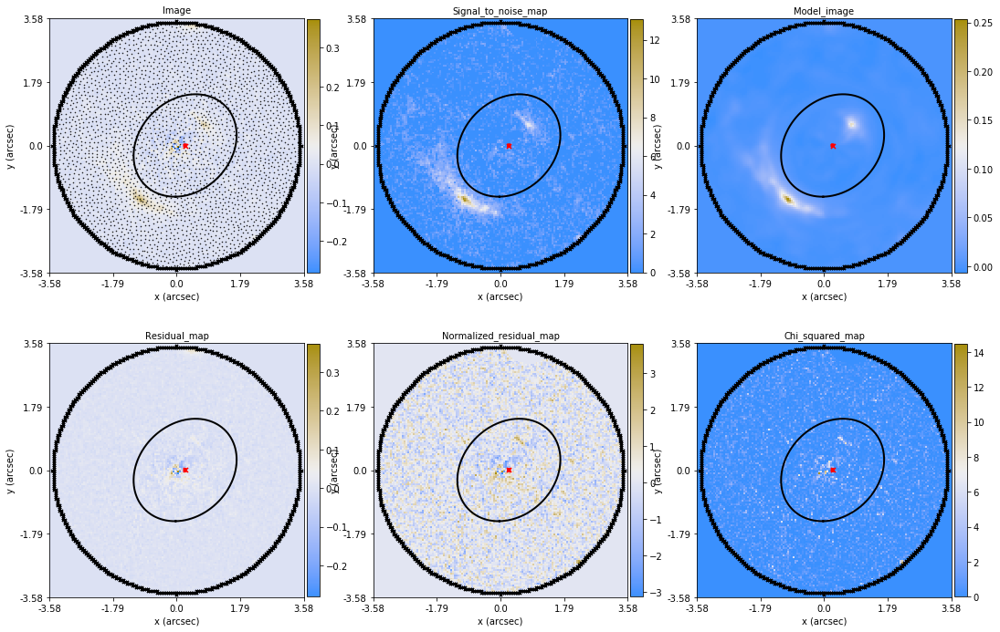

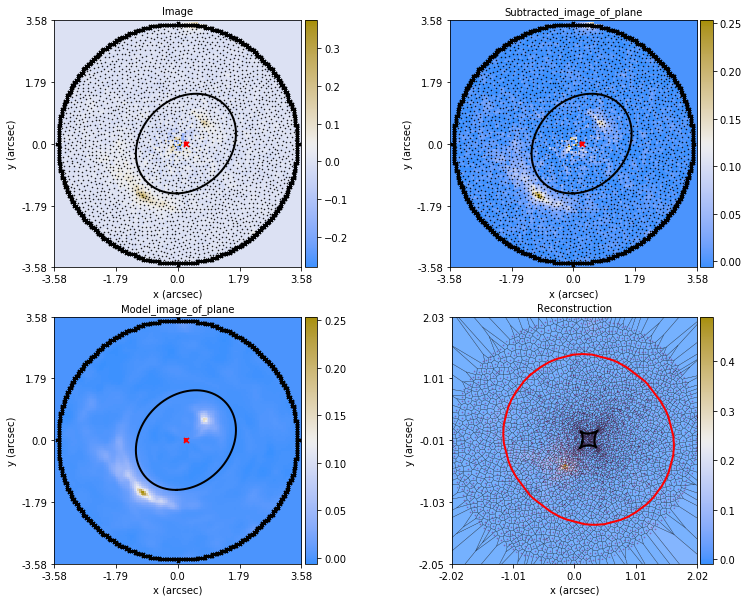

slacs0330-0020


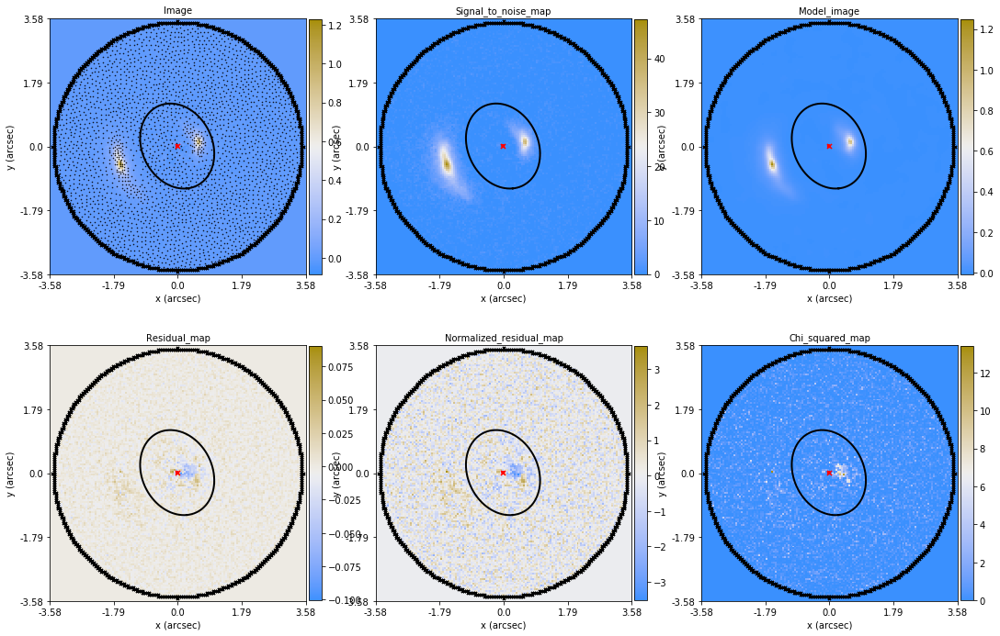

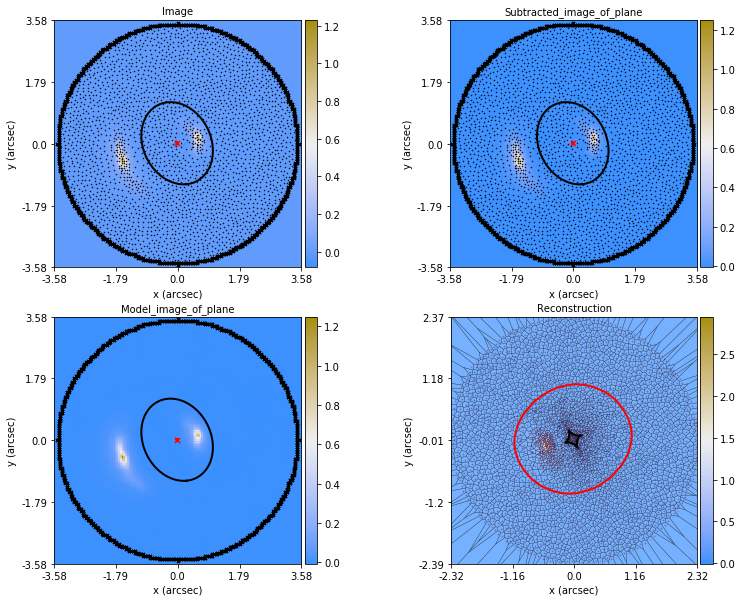

slacs0157-0056


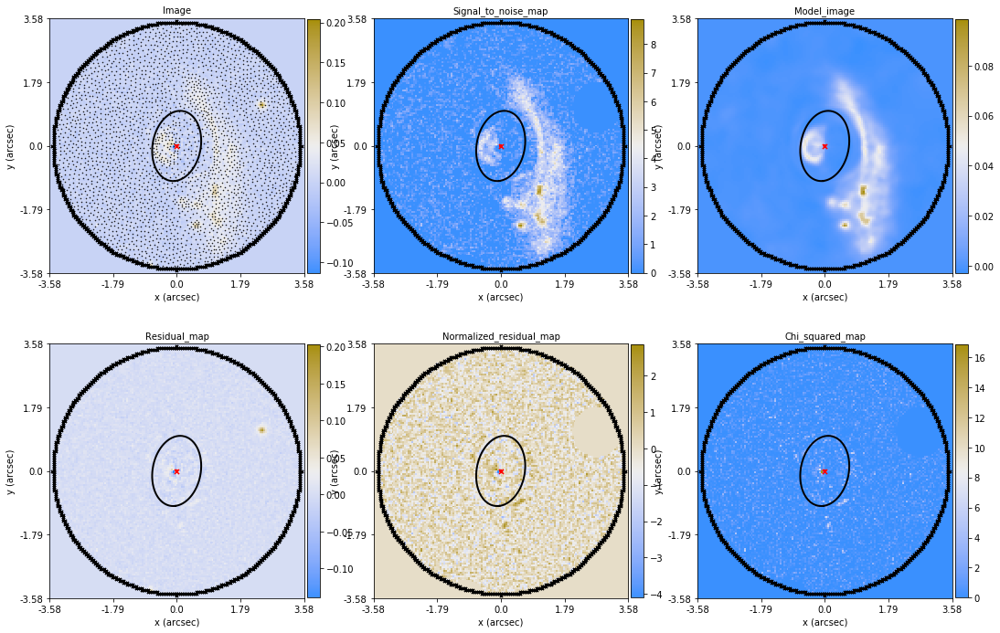

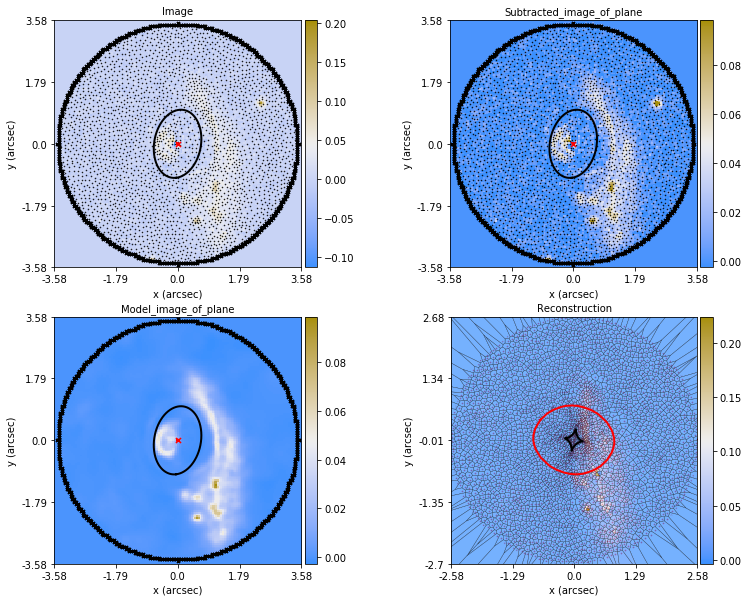

slacs0956+5100


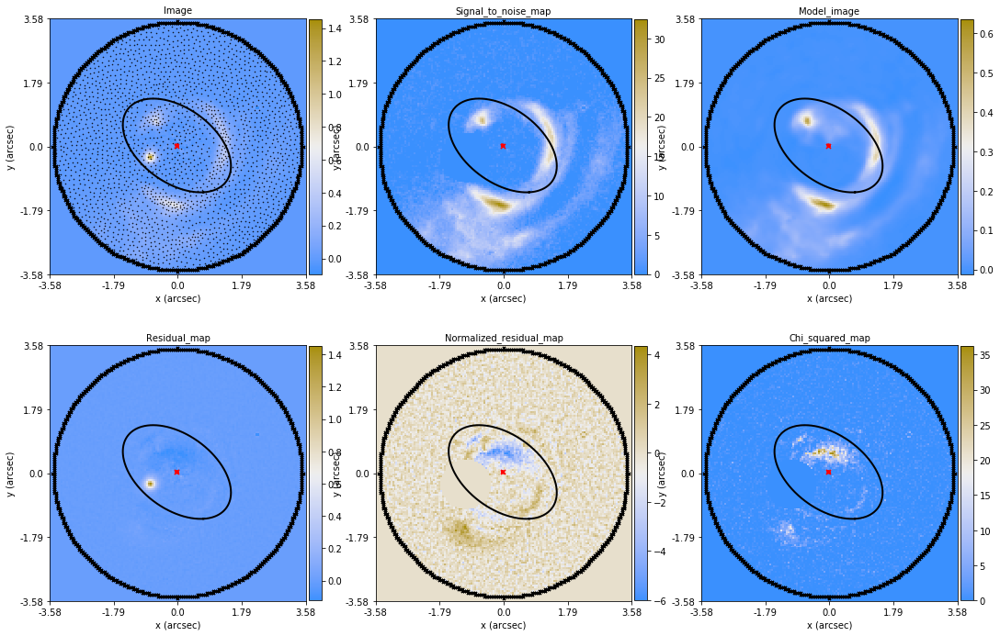

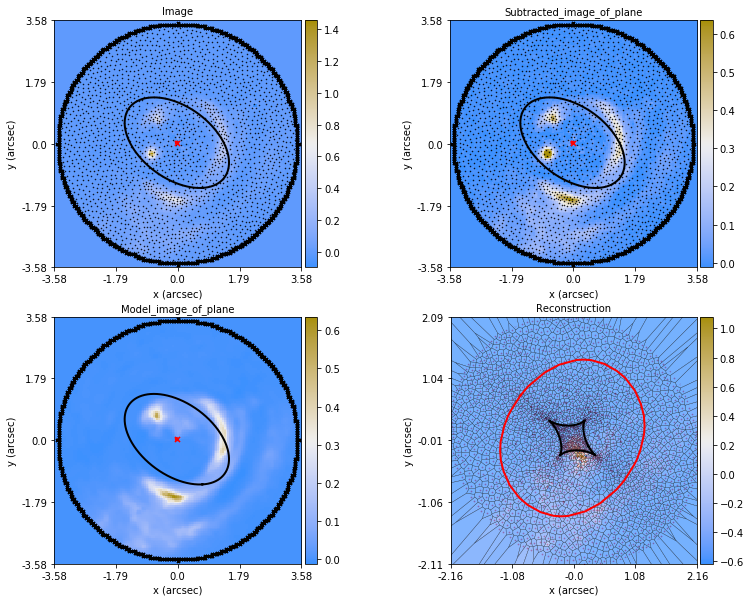

slacs1627-0053


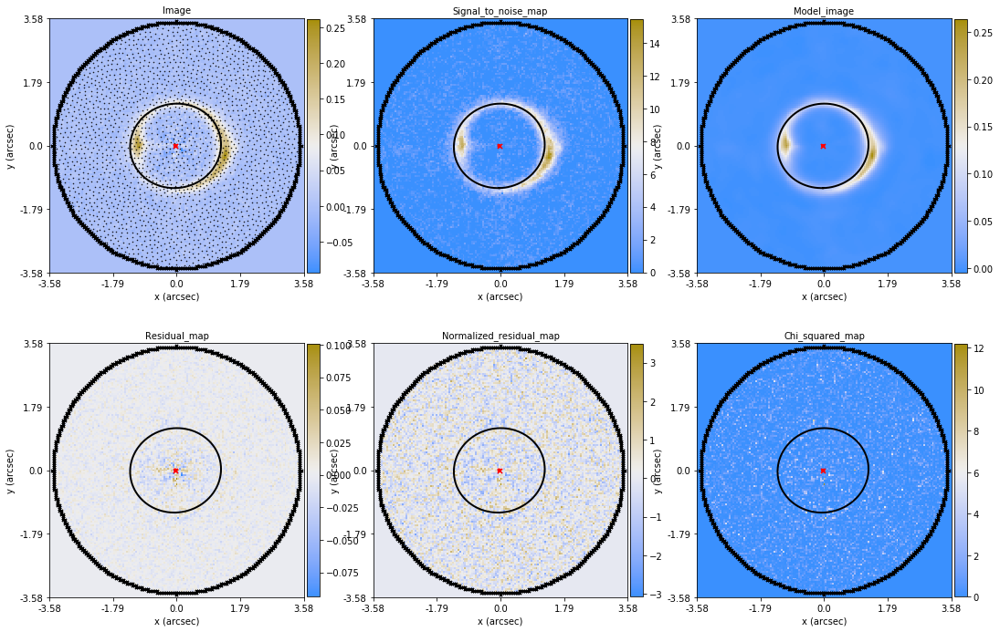

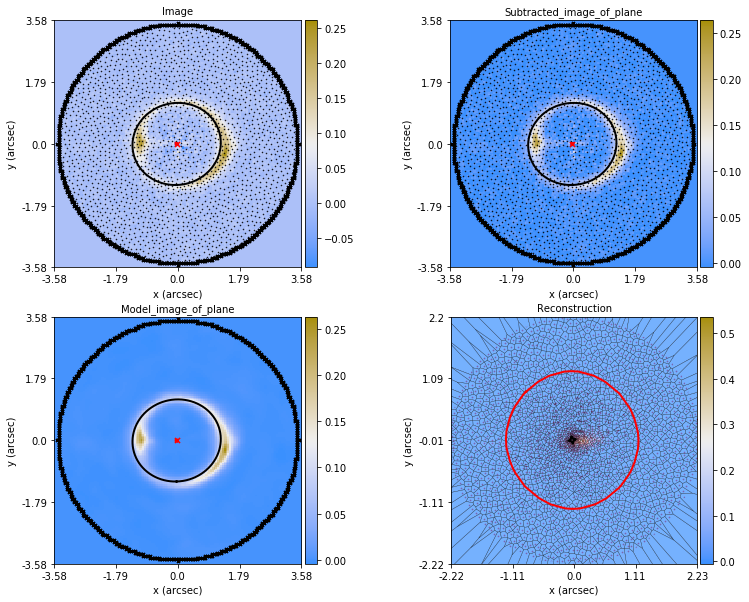

slacs1525+3327


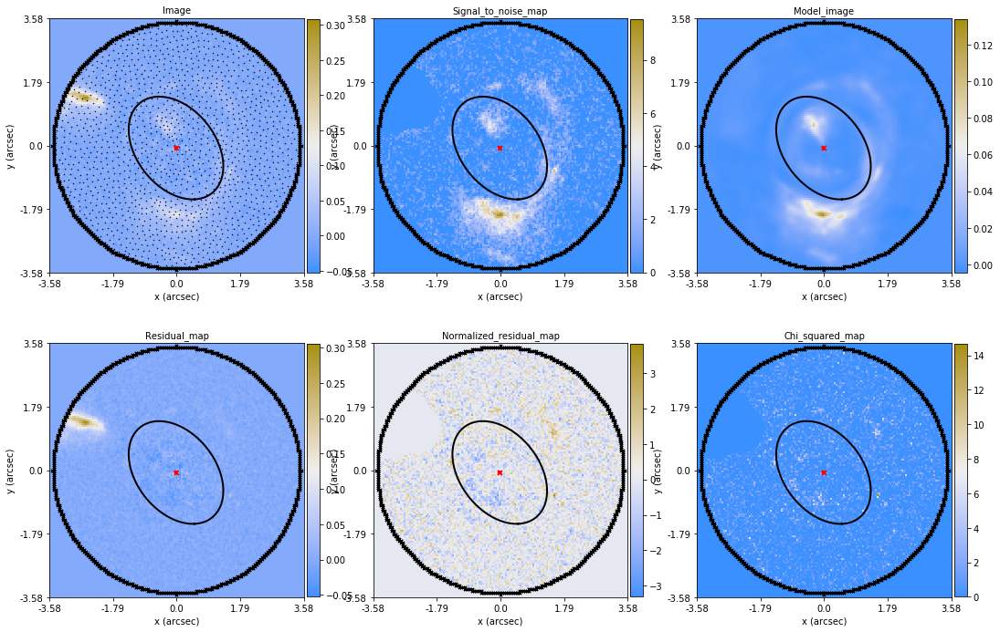

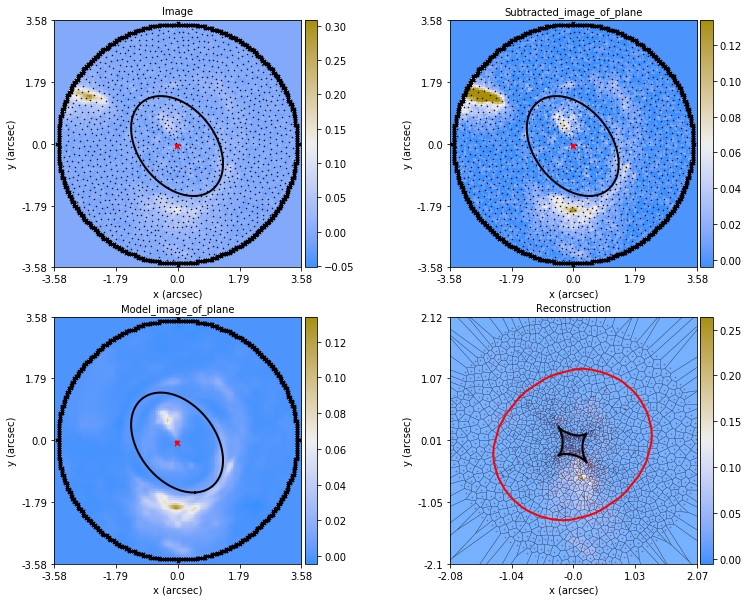

slacs0903+4116


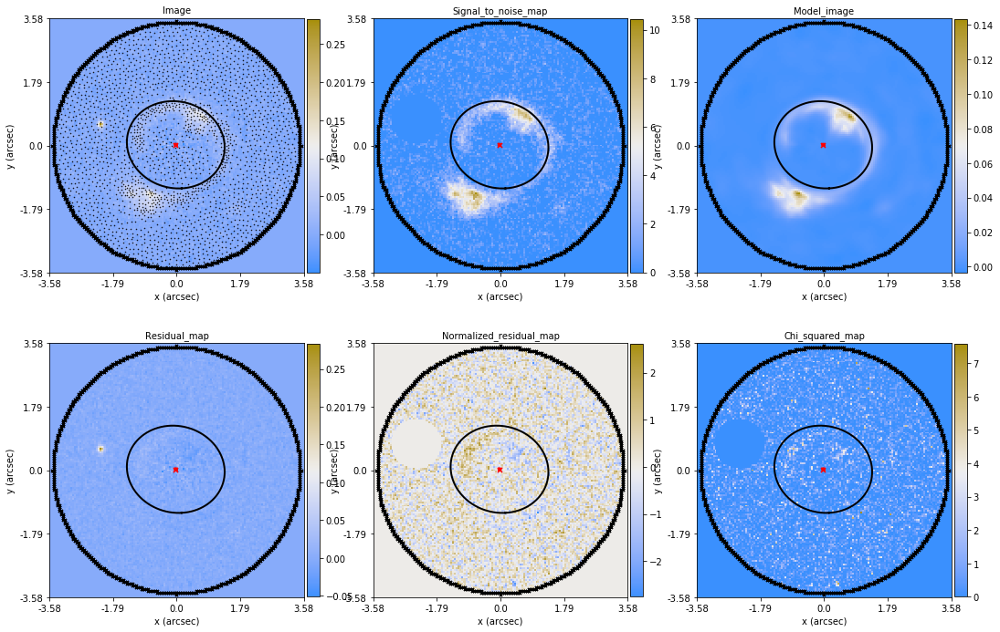

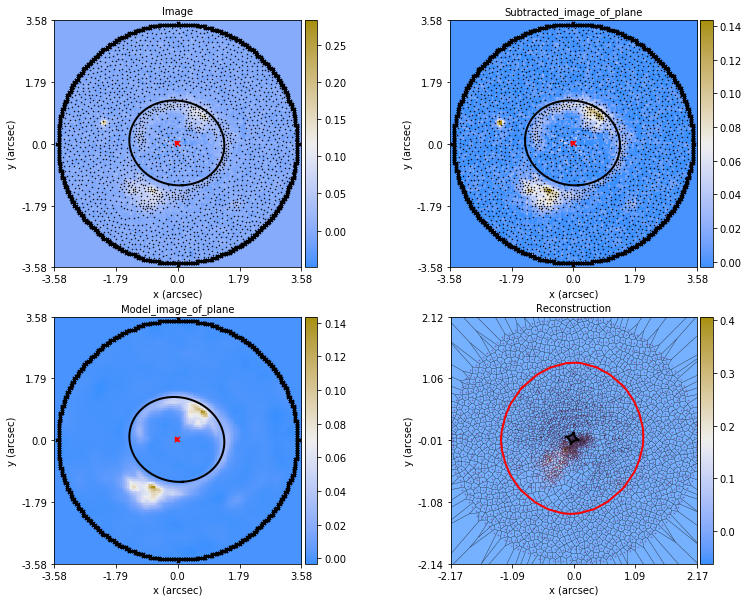

slacs1630+4520


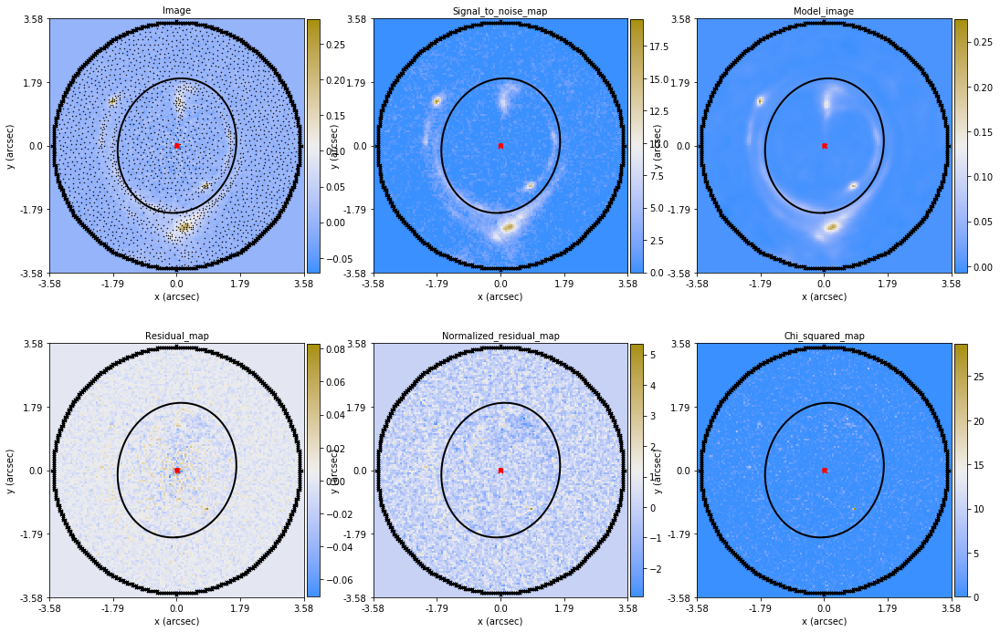

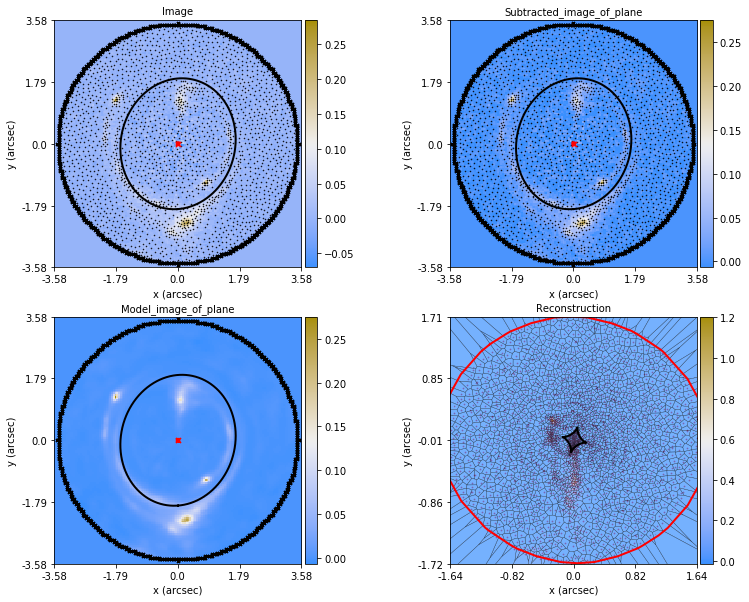

slacs1029+0420


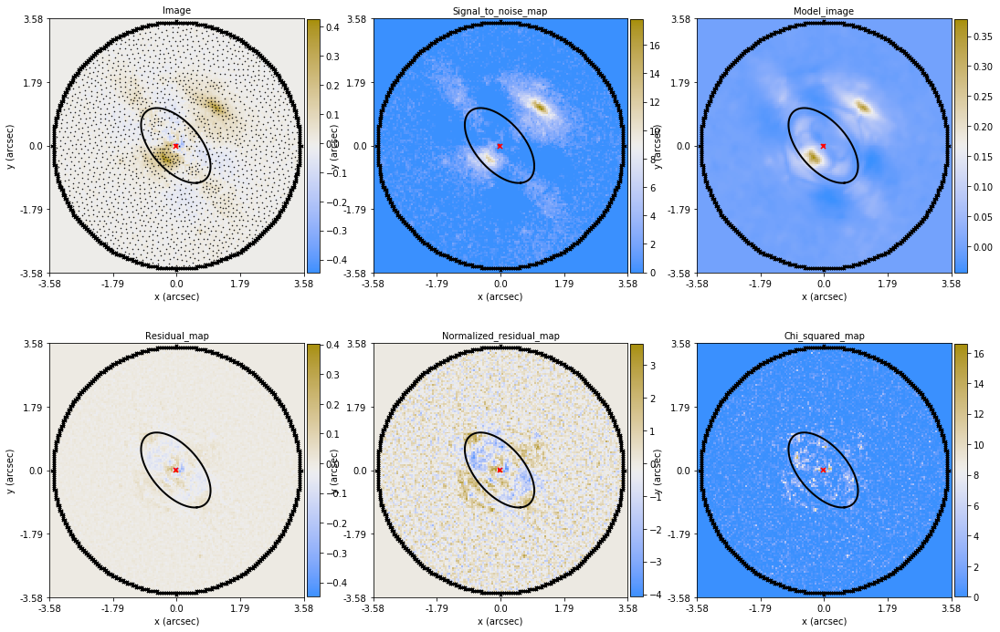

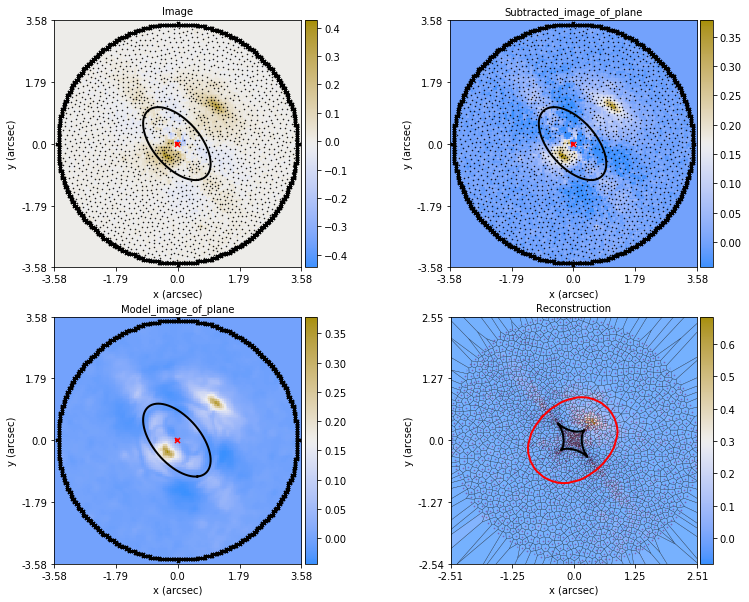

slacs0737+3216


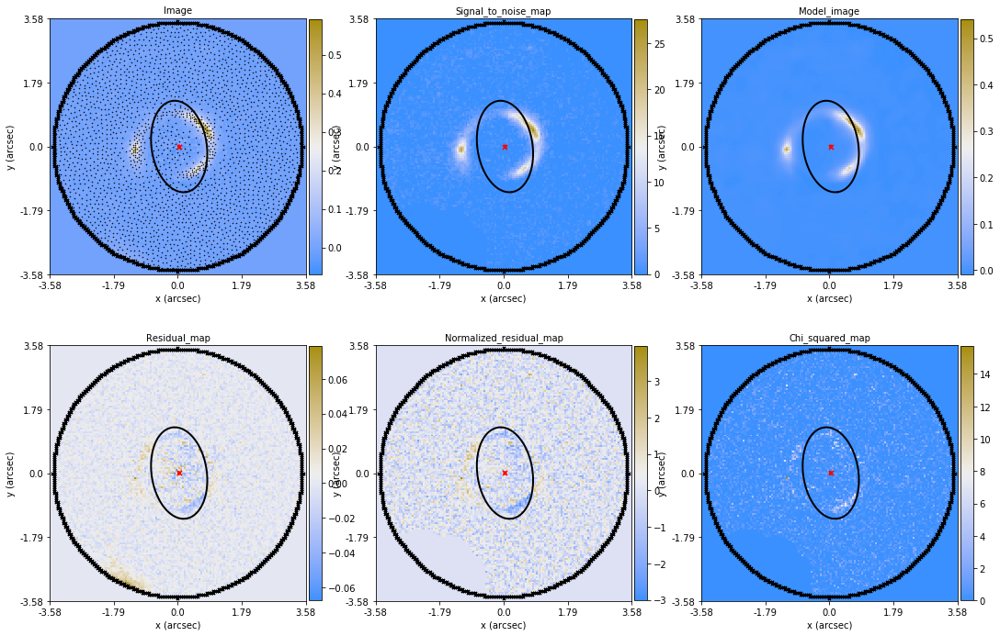

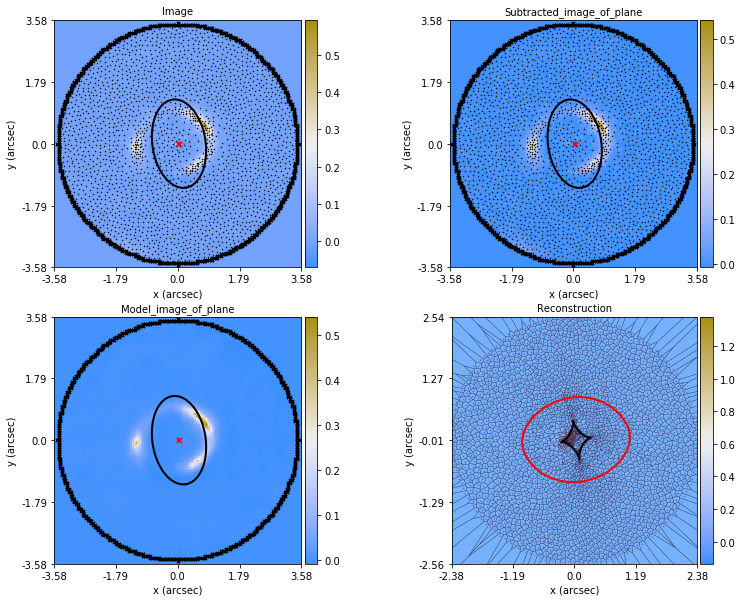

slacs0841+3824


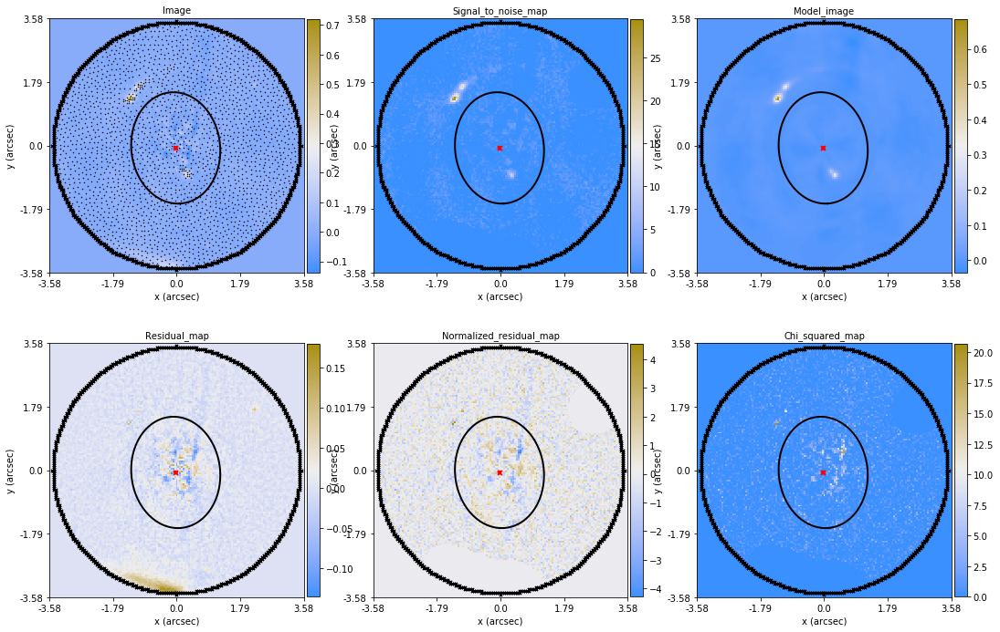

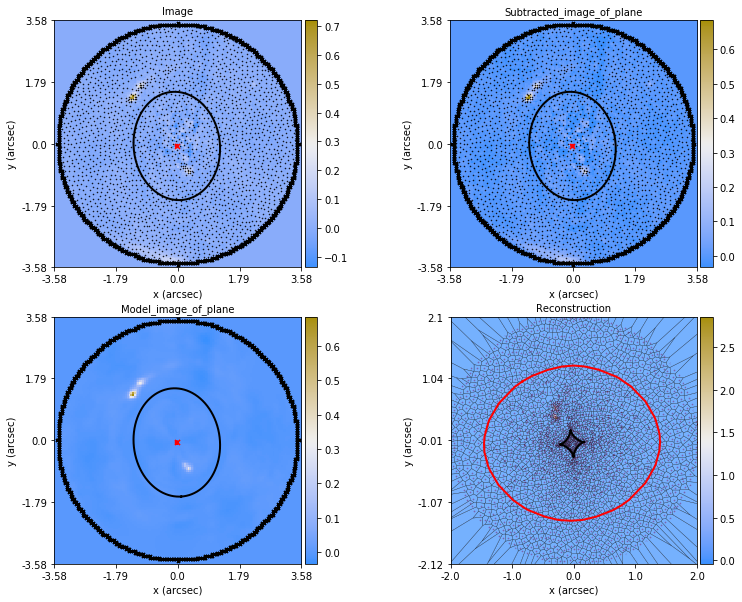

slacs2303+1422


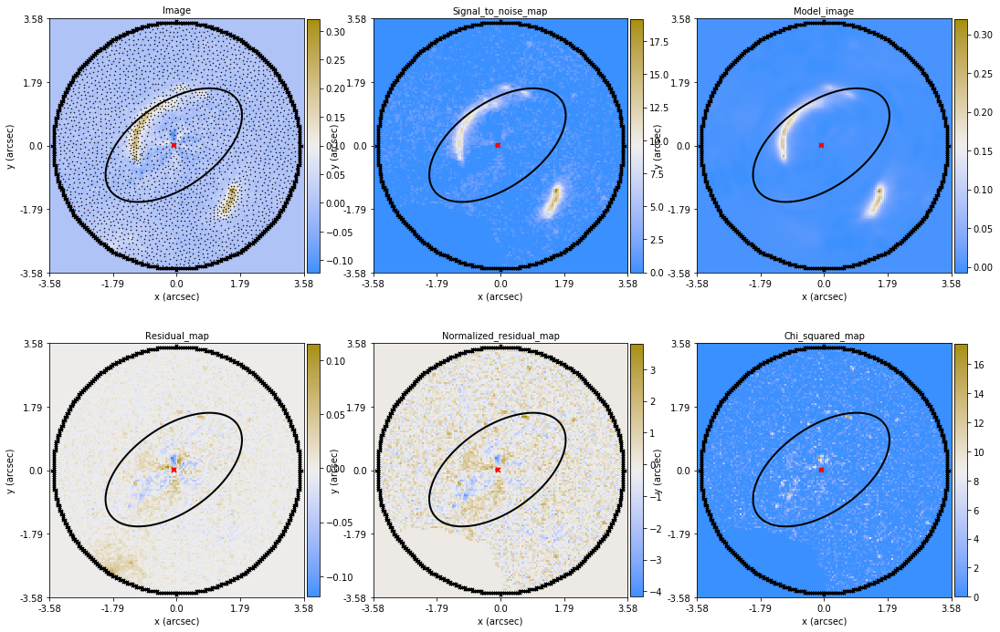

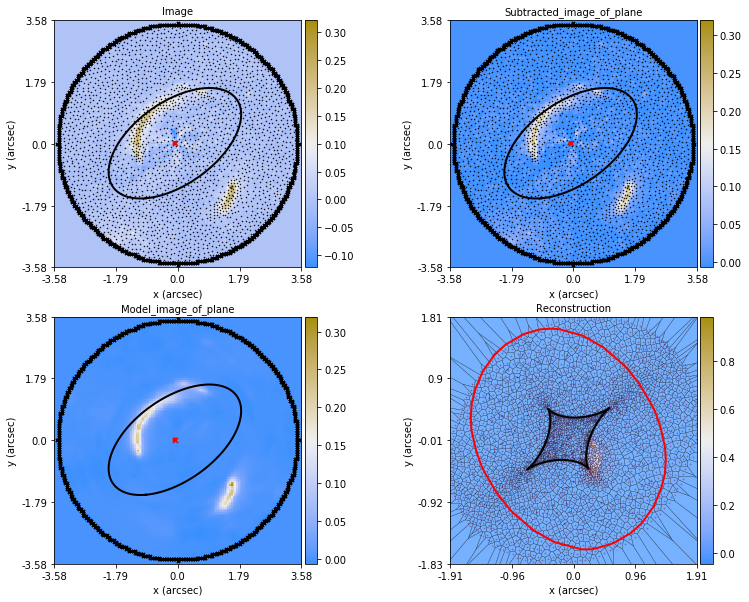

slacs1420+6019


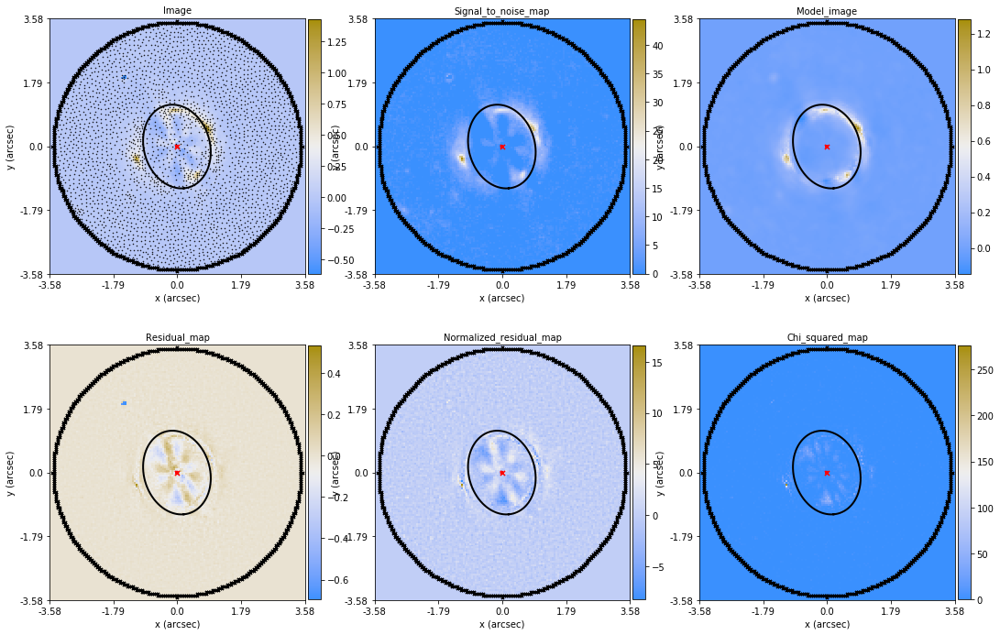

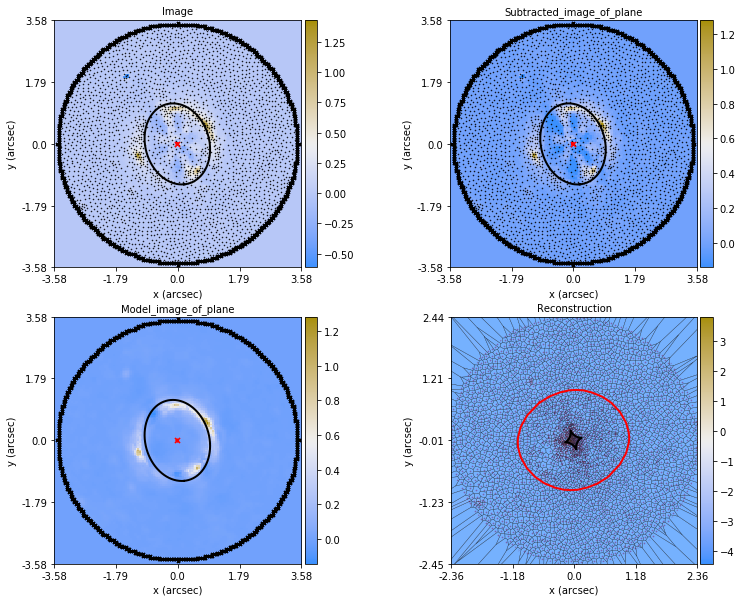

slacs1142+1001


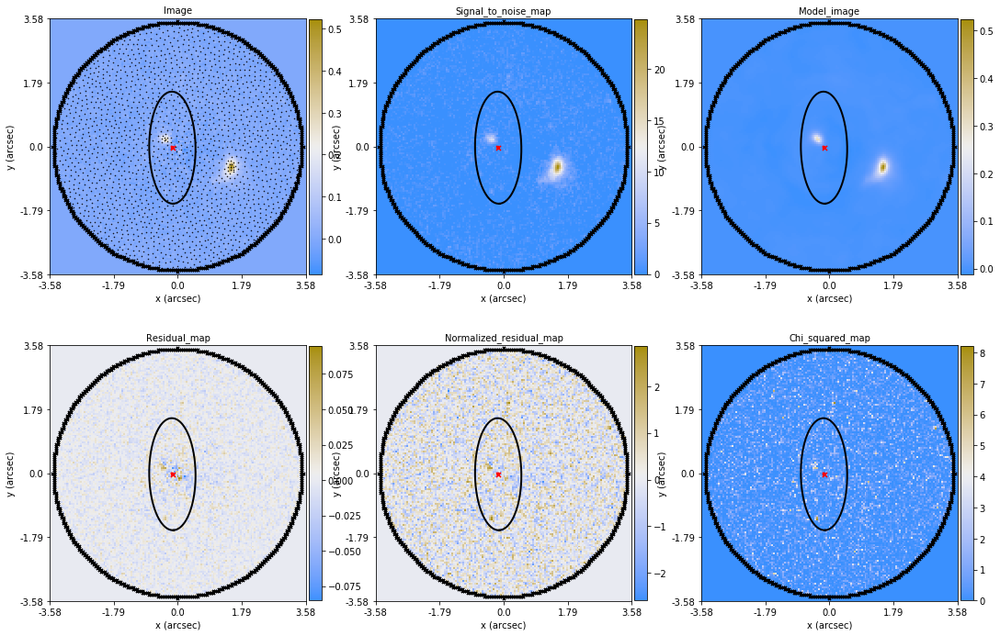

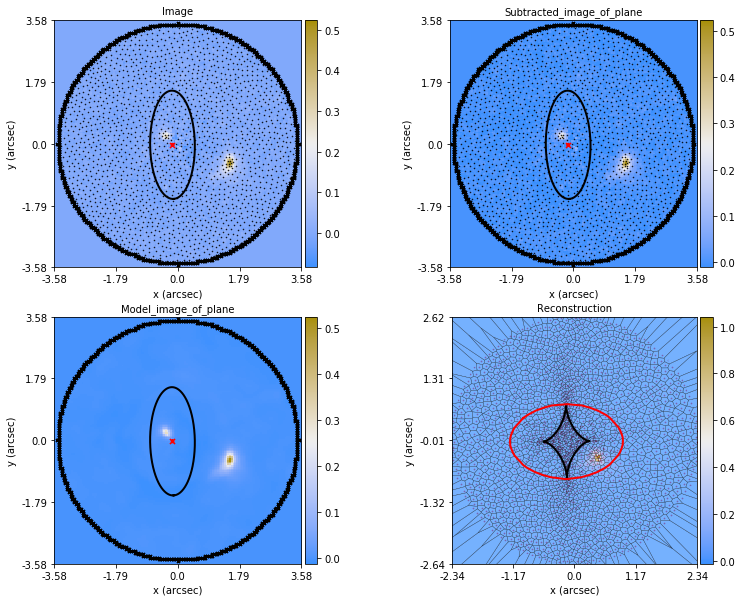

slacs1143-0144


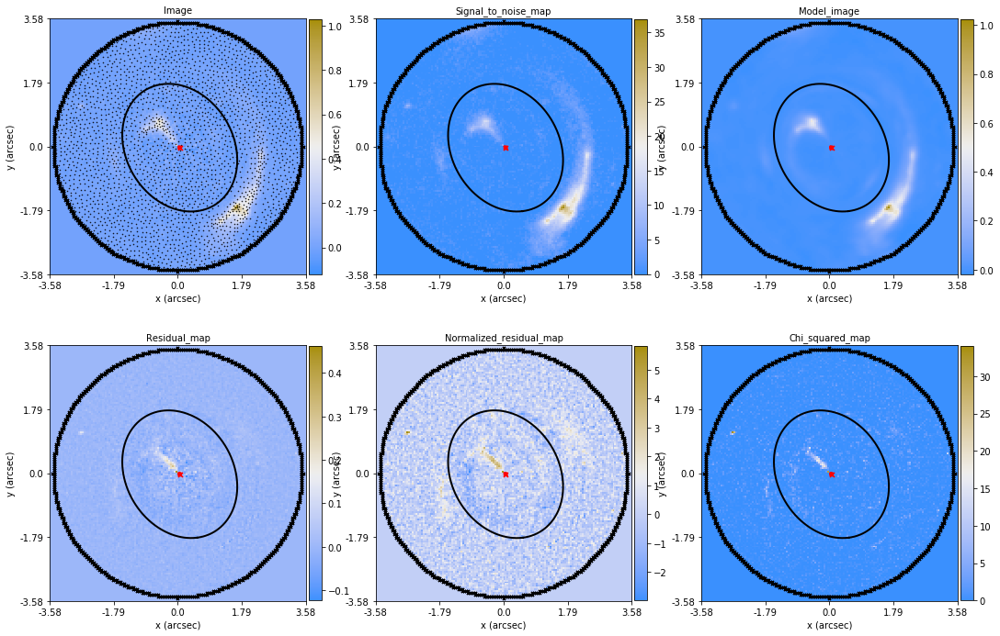

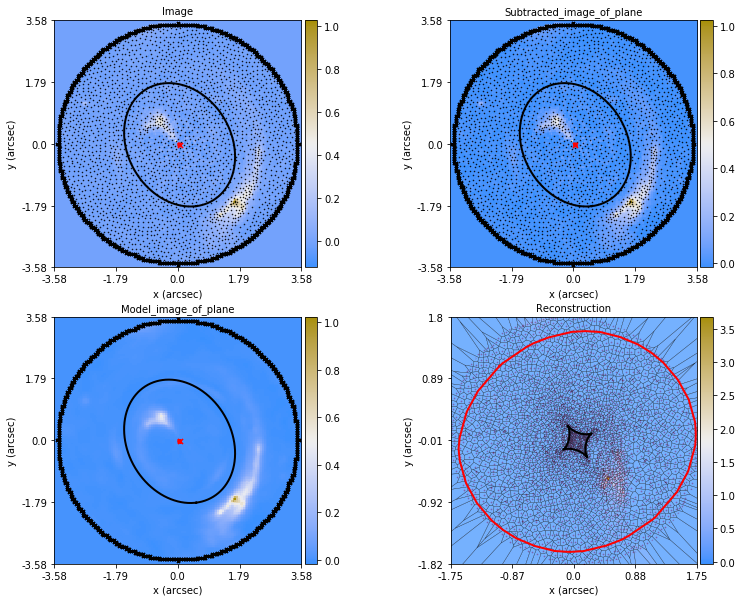

slacs1218+0830


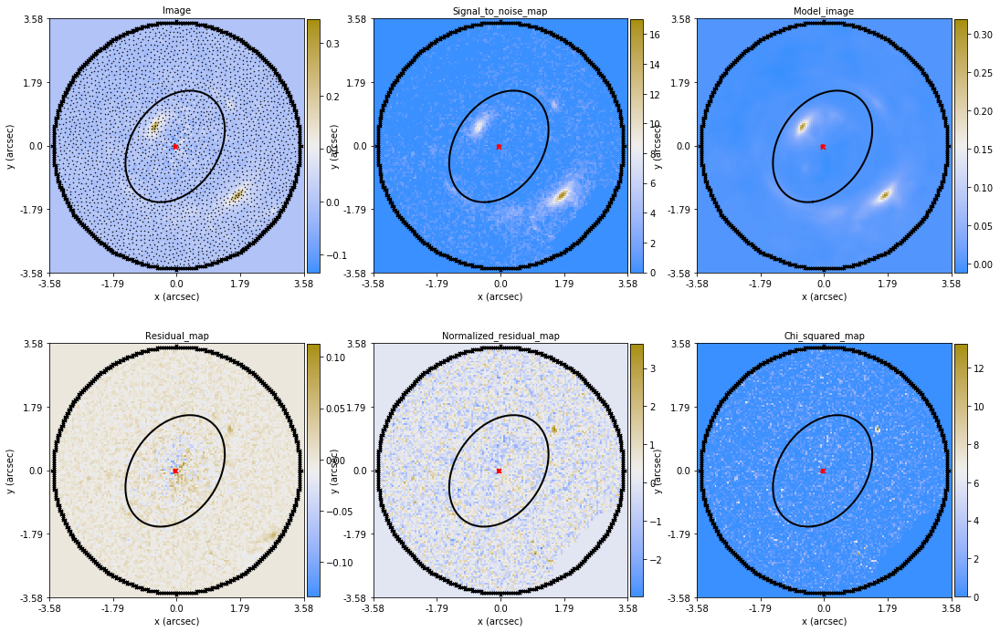

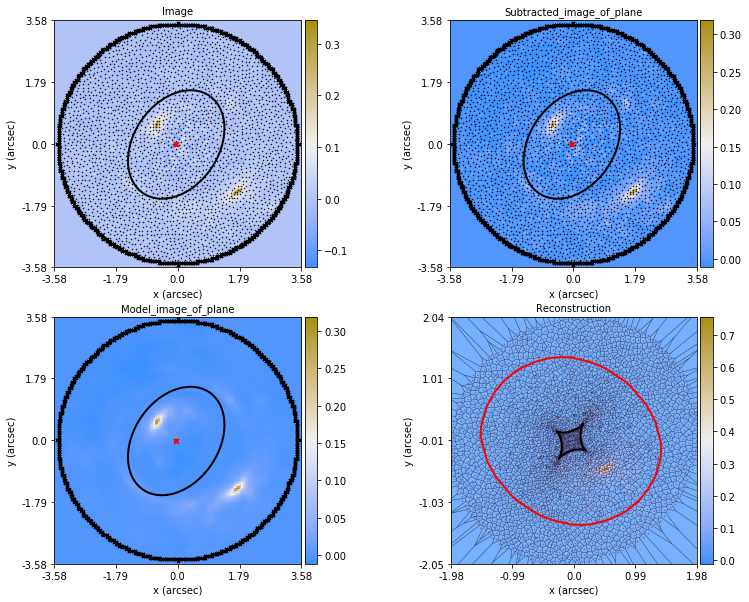

slacs1103+5322


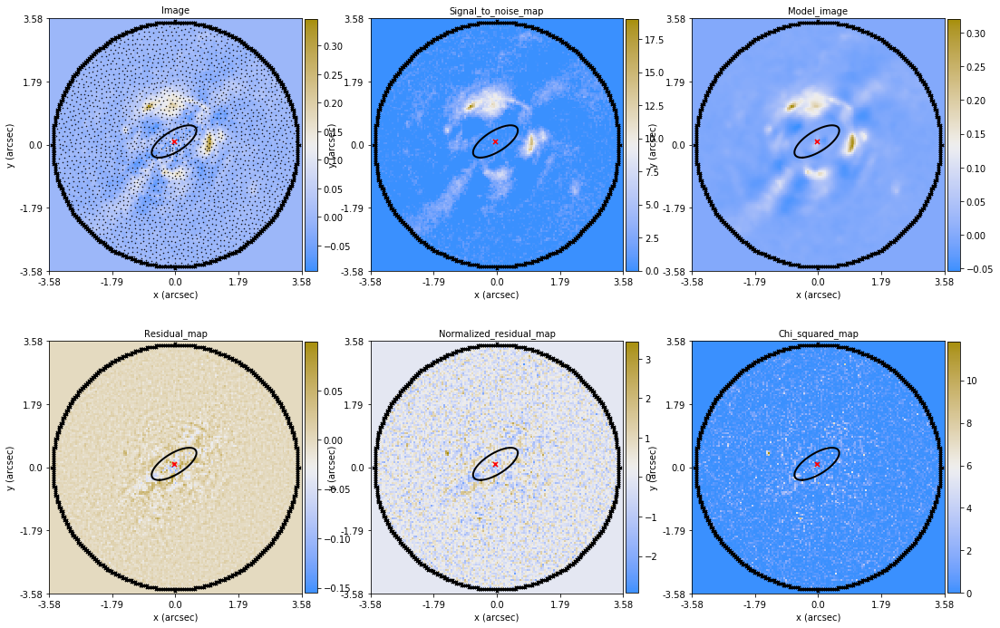

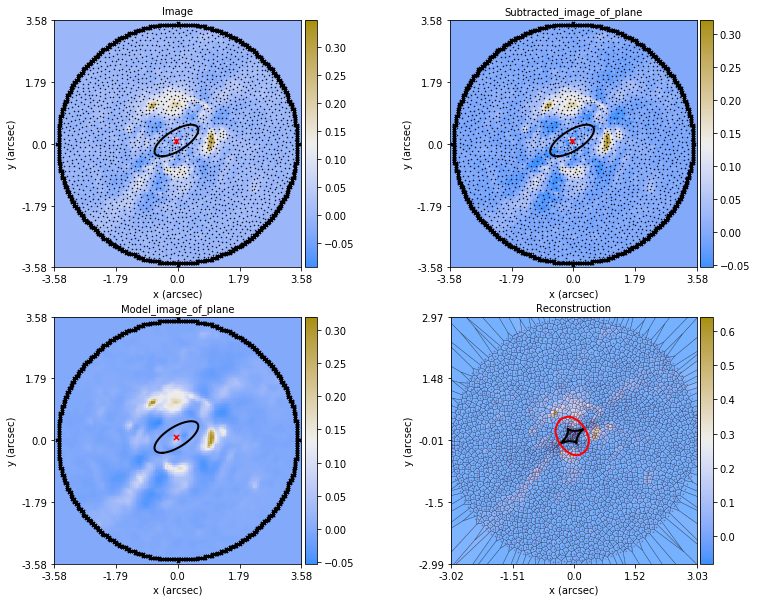

slacs1023+4230


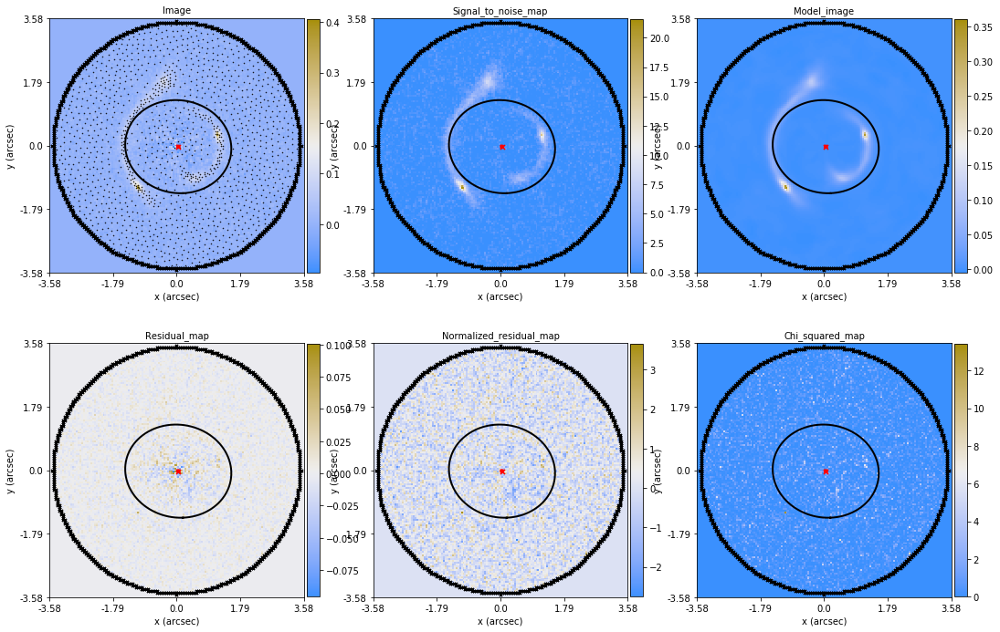

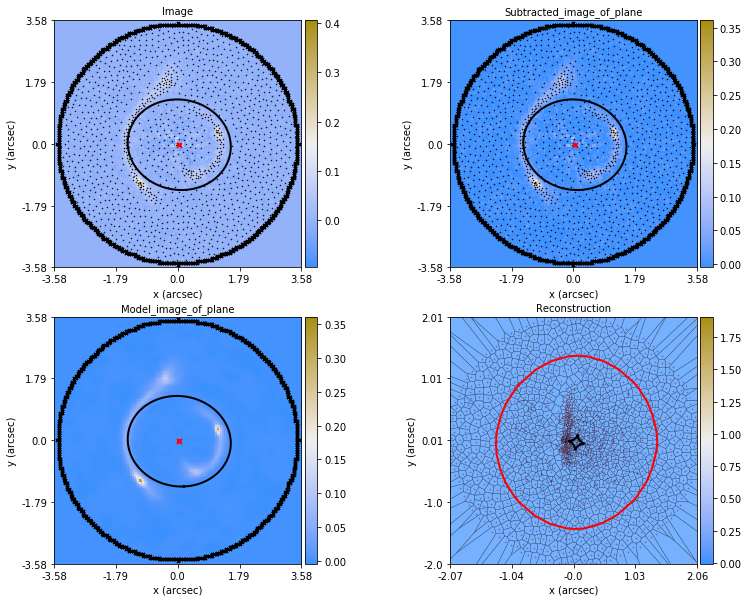

slacs1430+4105


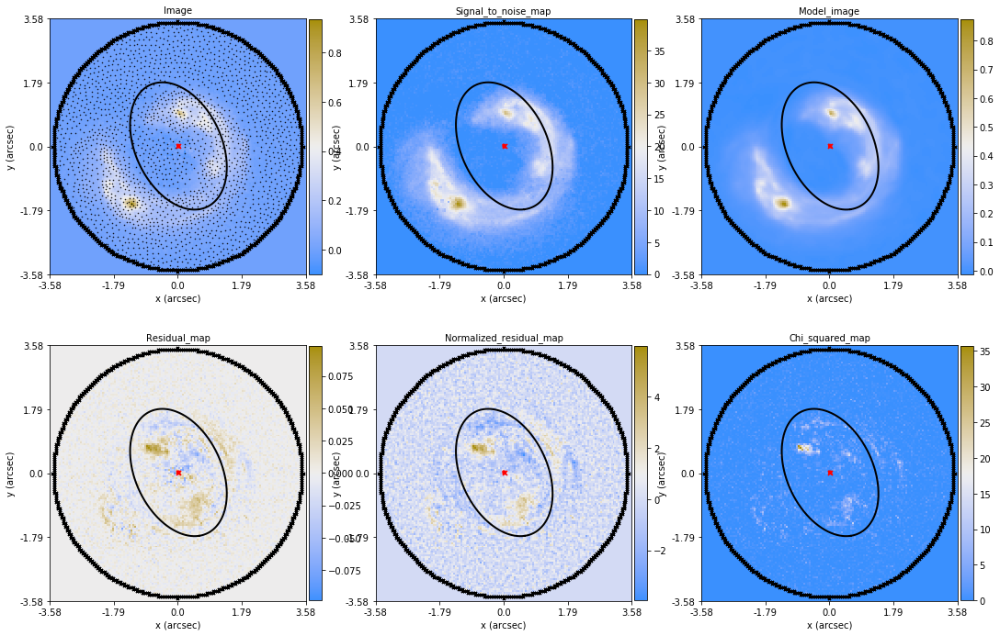

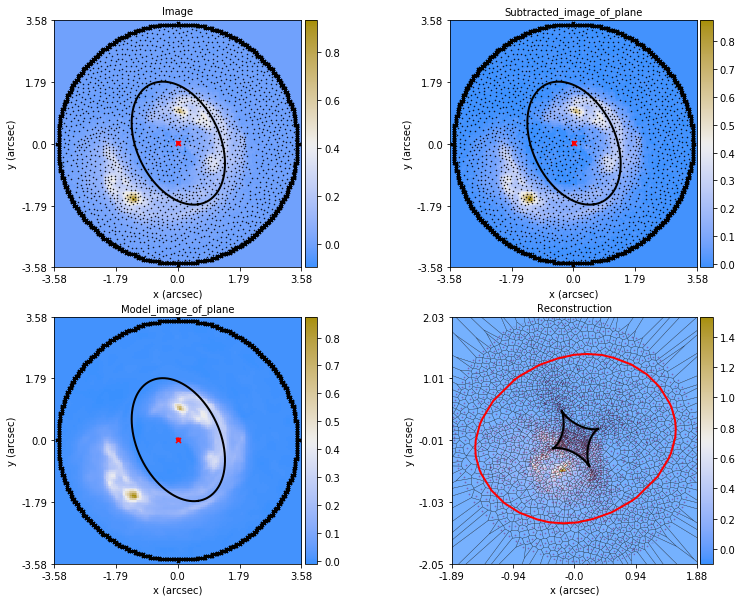

slacs1020+1122


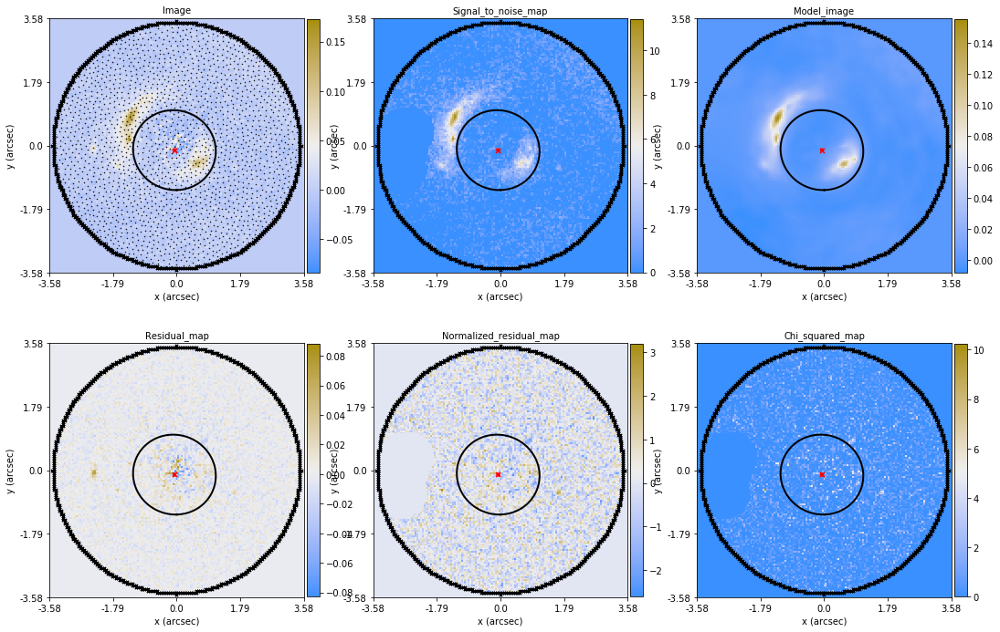

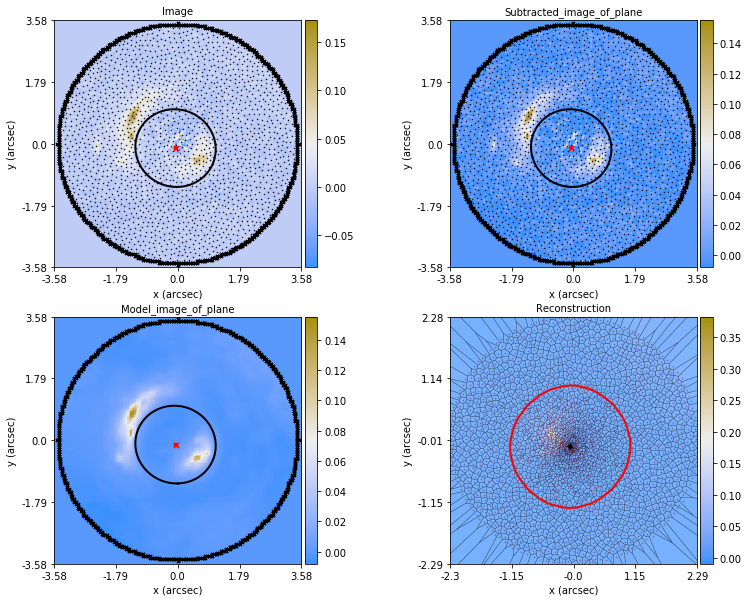

slacs1032+5322


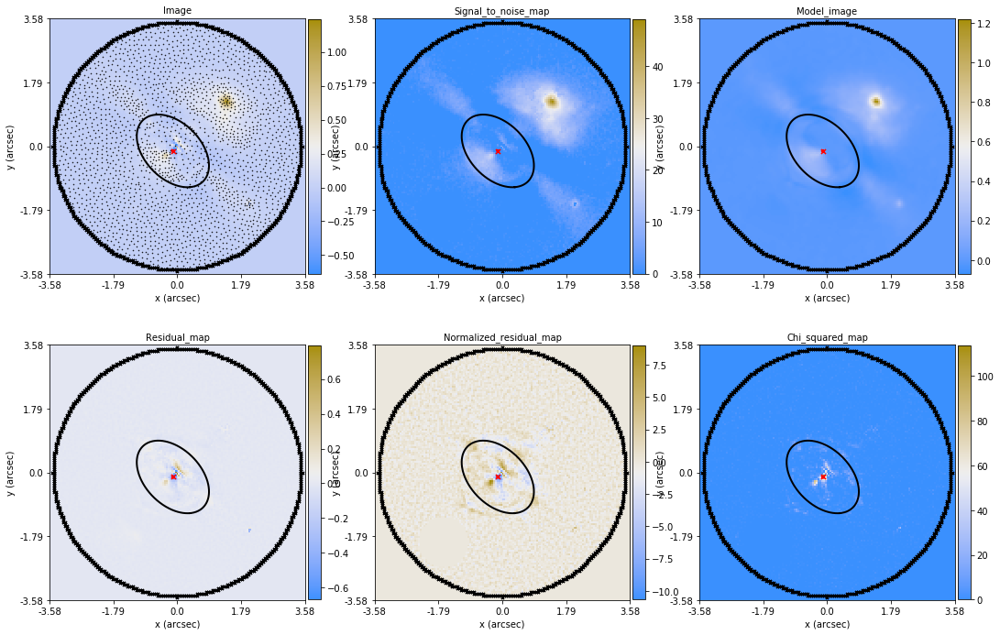

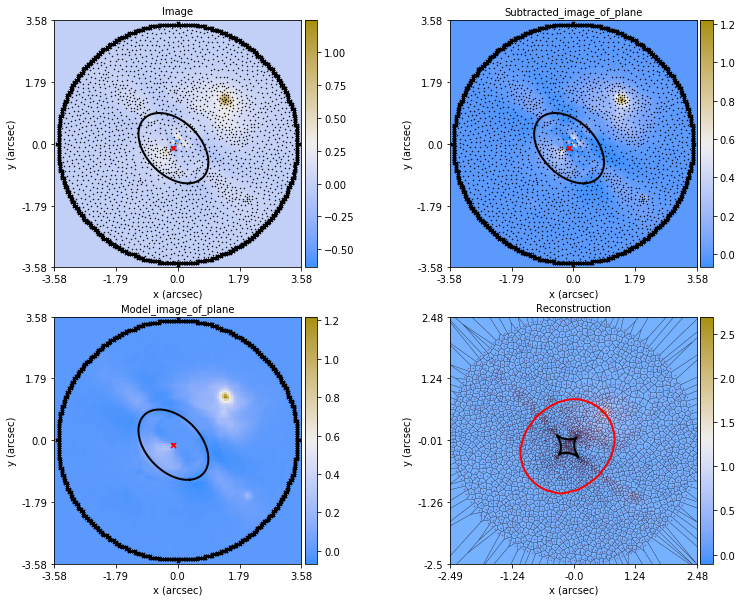

slacs1432+6317


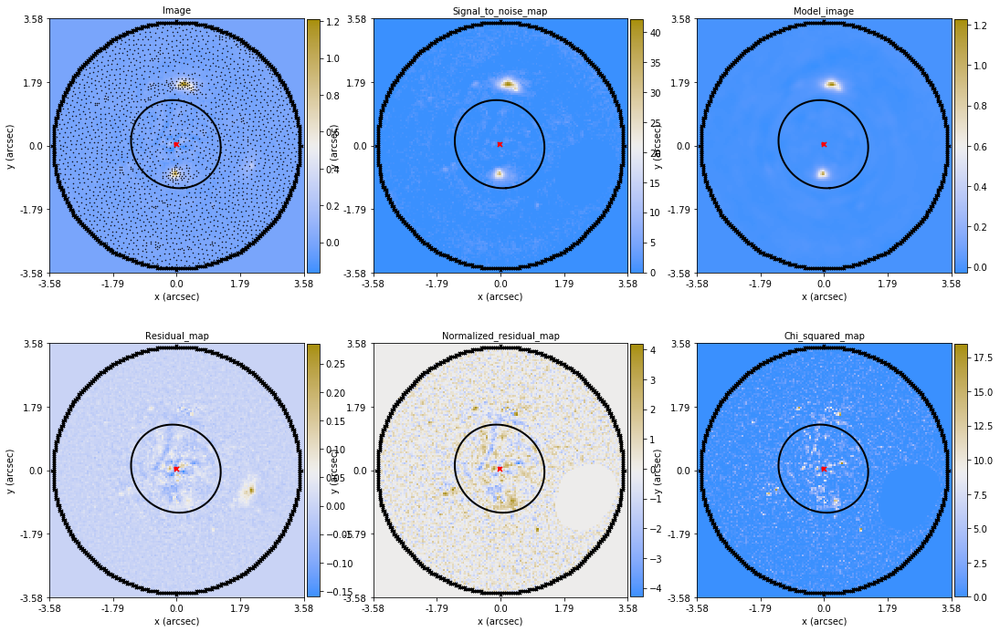

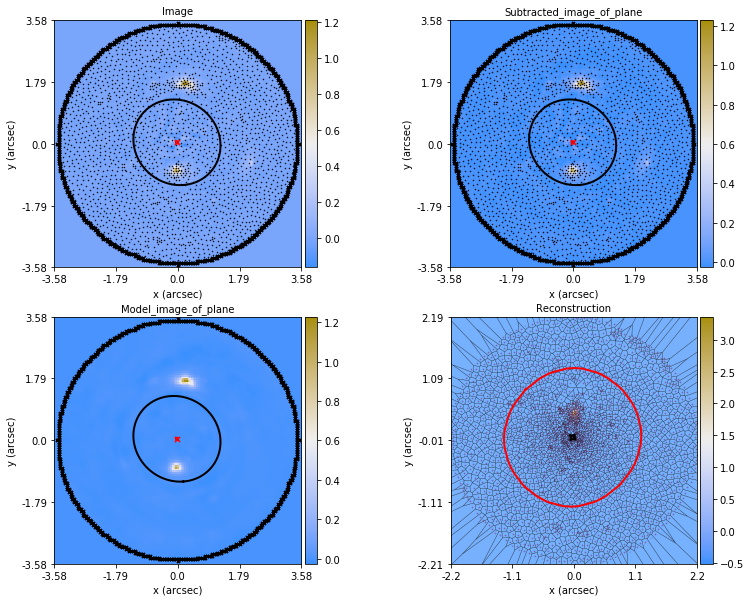

slacs1451-0239


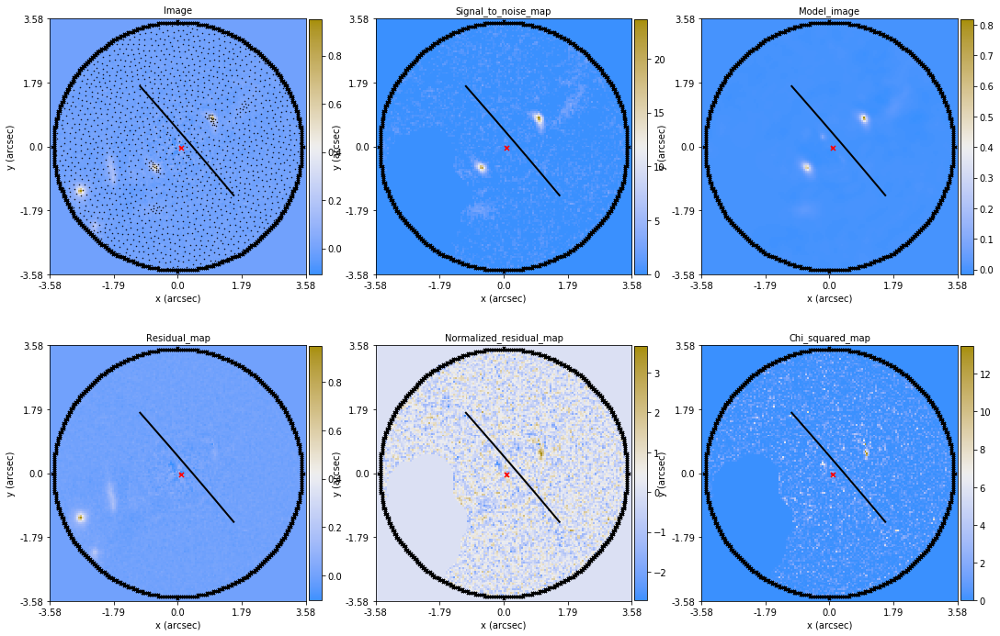

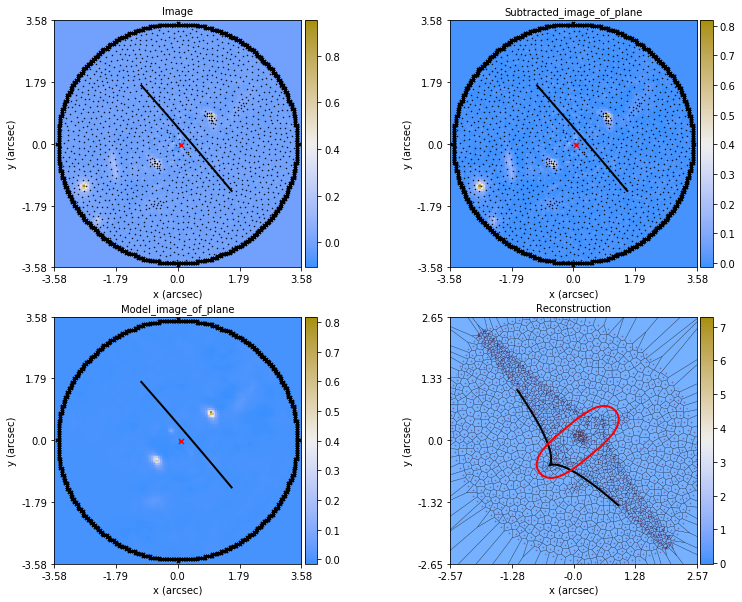

slacs2300+0022


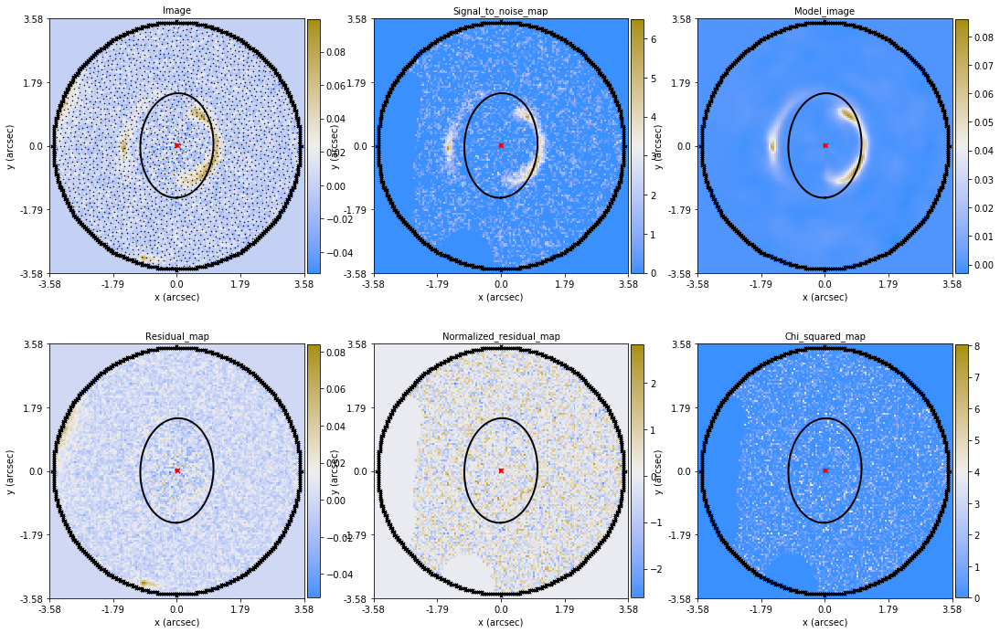

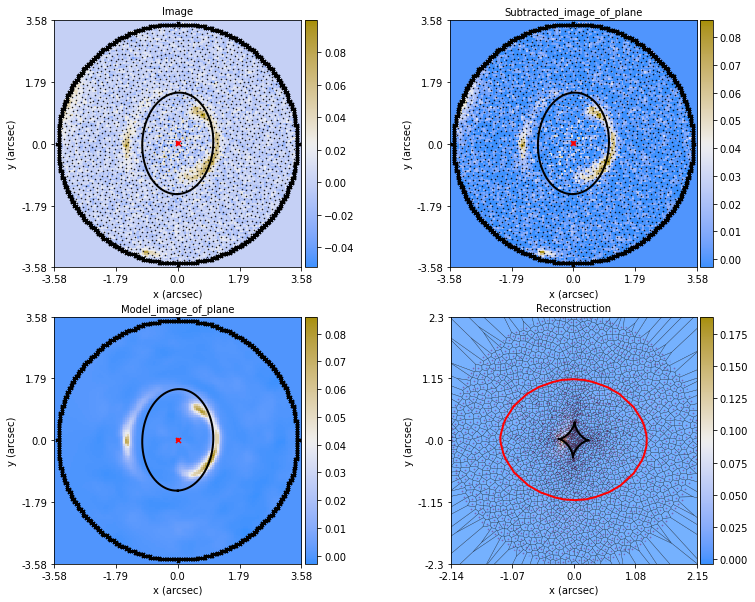

slacs0728+3835


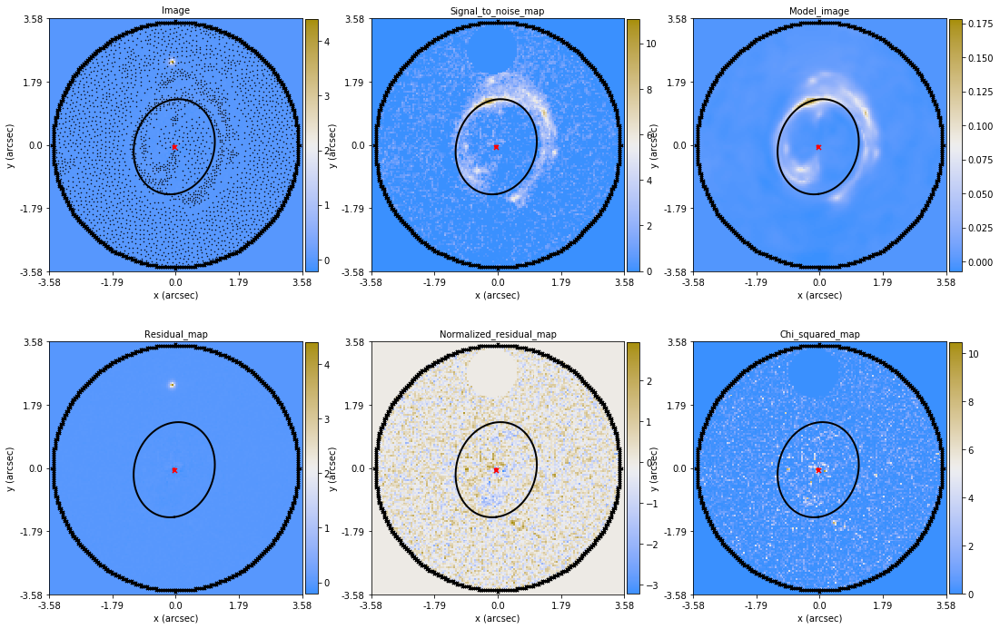

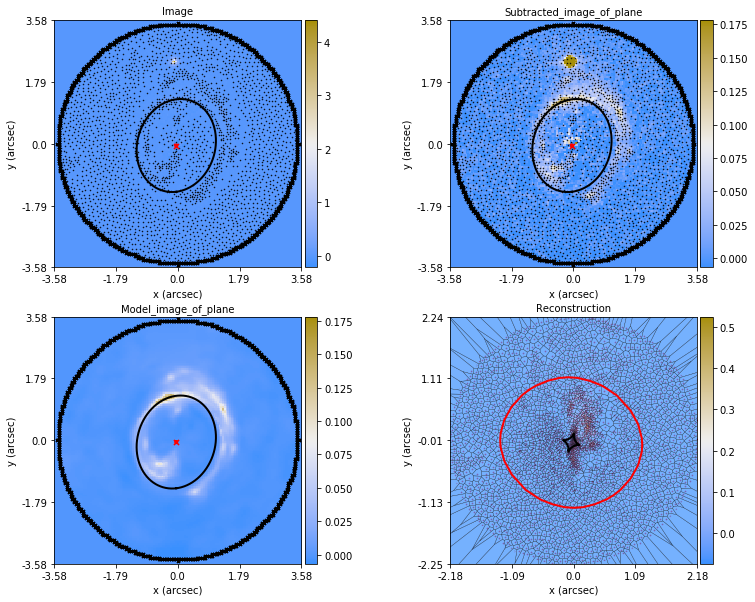

slacs0946+1006


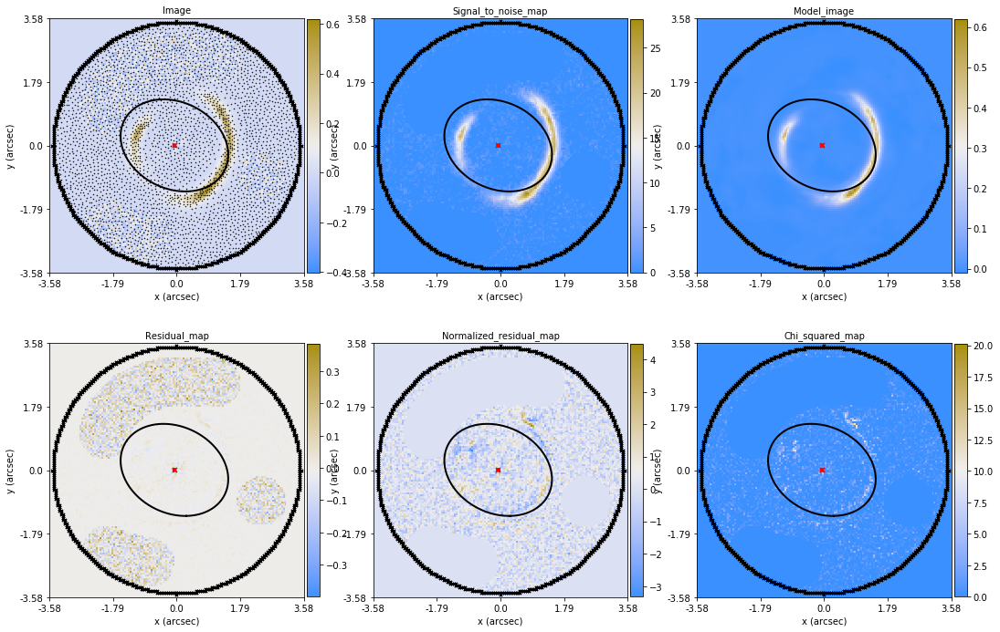

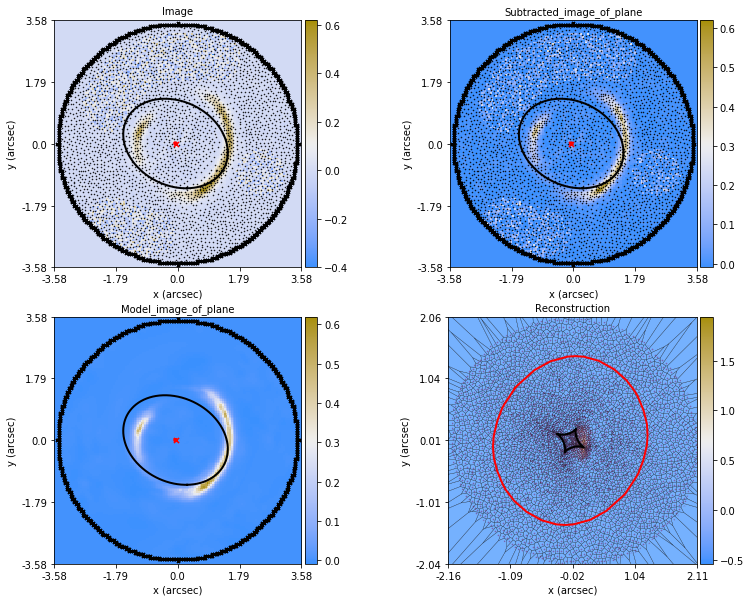

slacs1416+5136


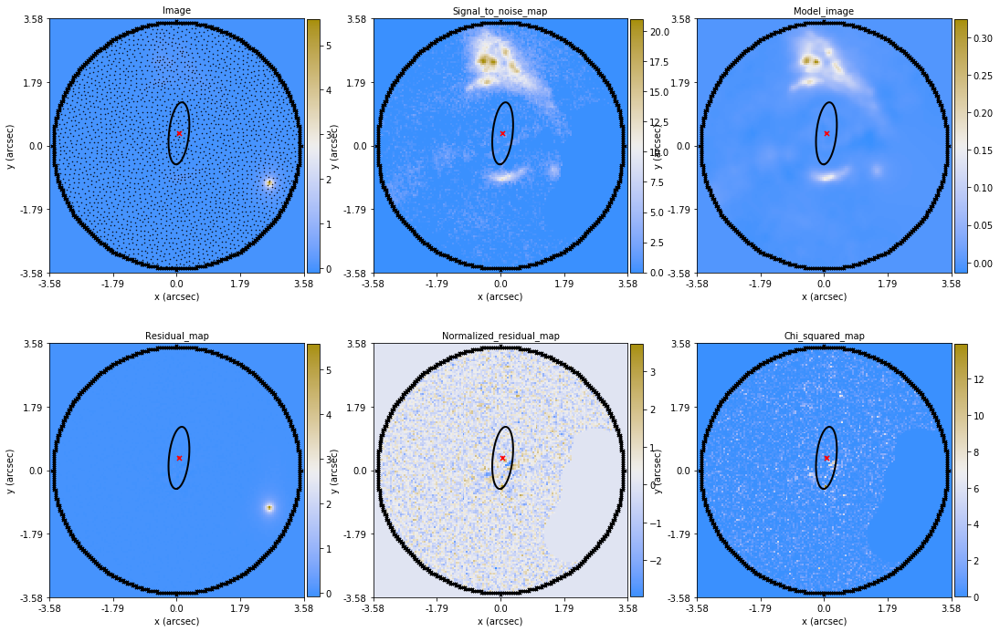

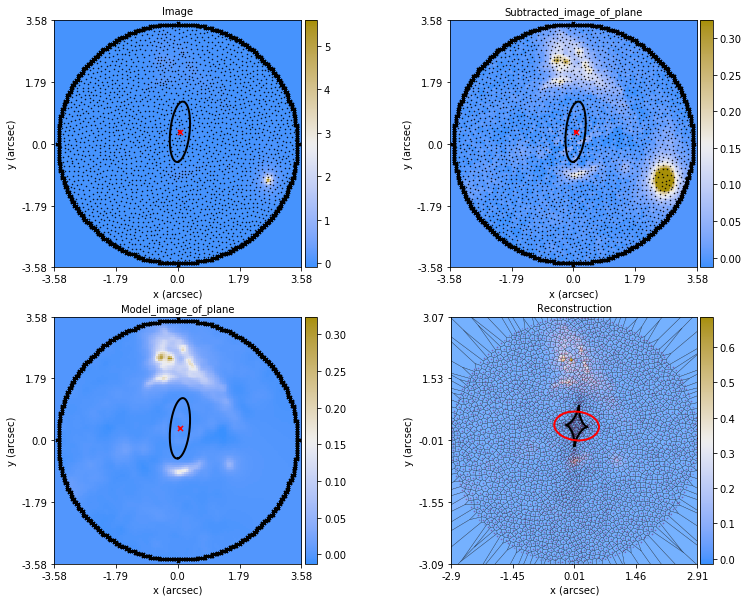

slacs0252+0039


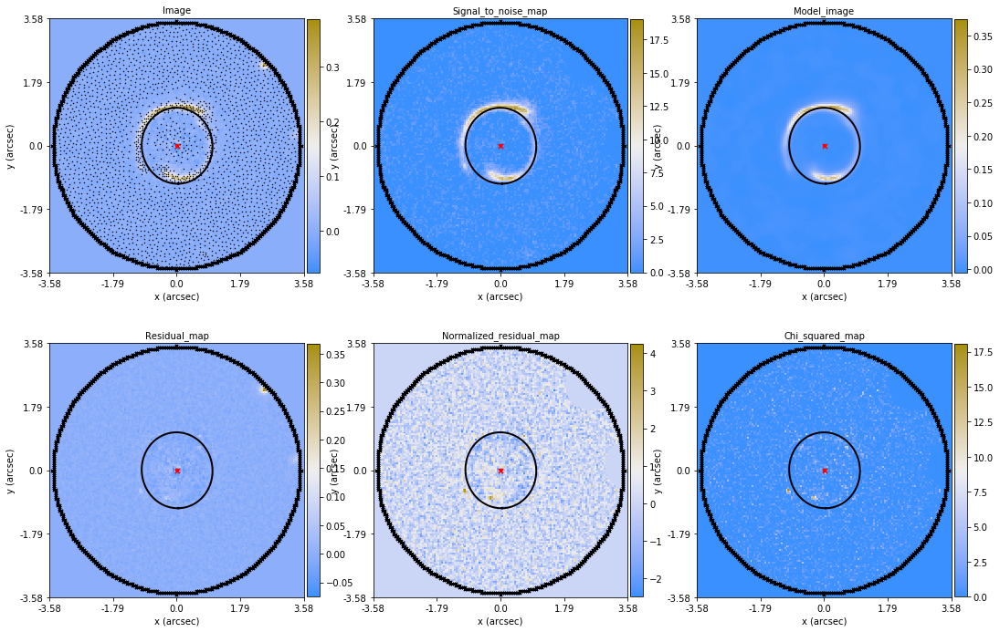

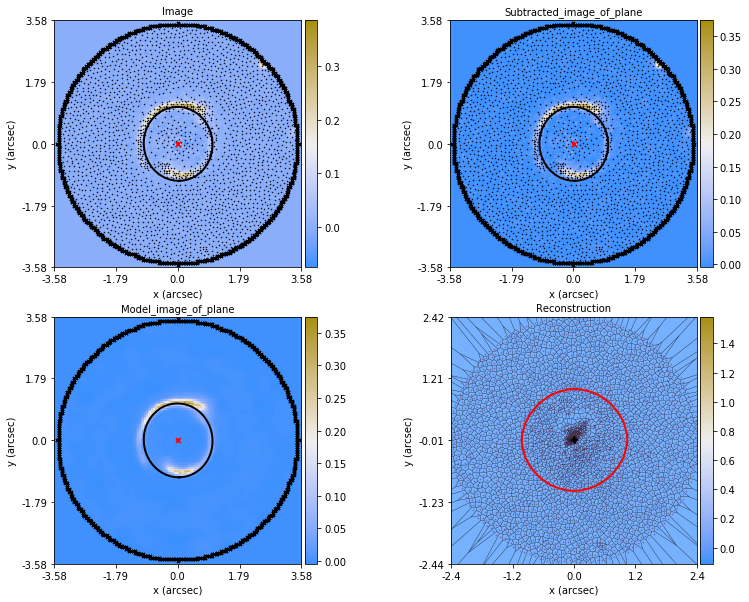

slacs0912+0029


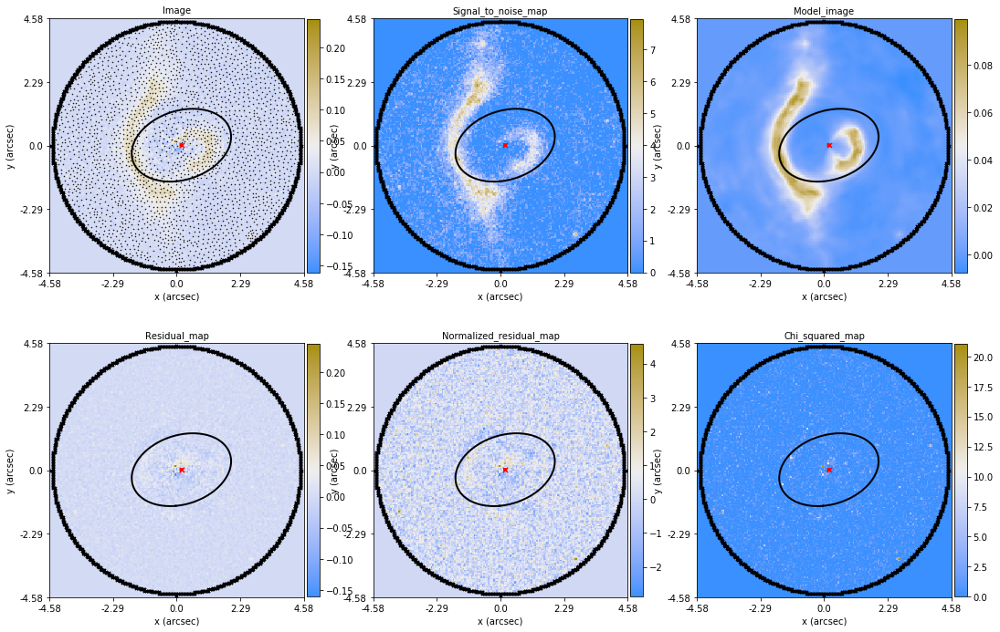

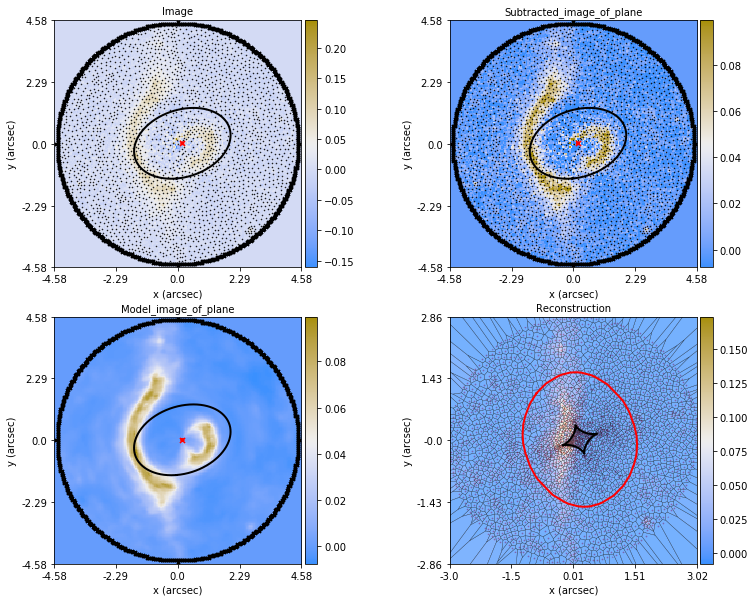

slacs0029-0055


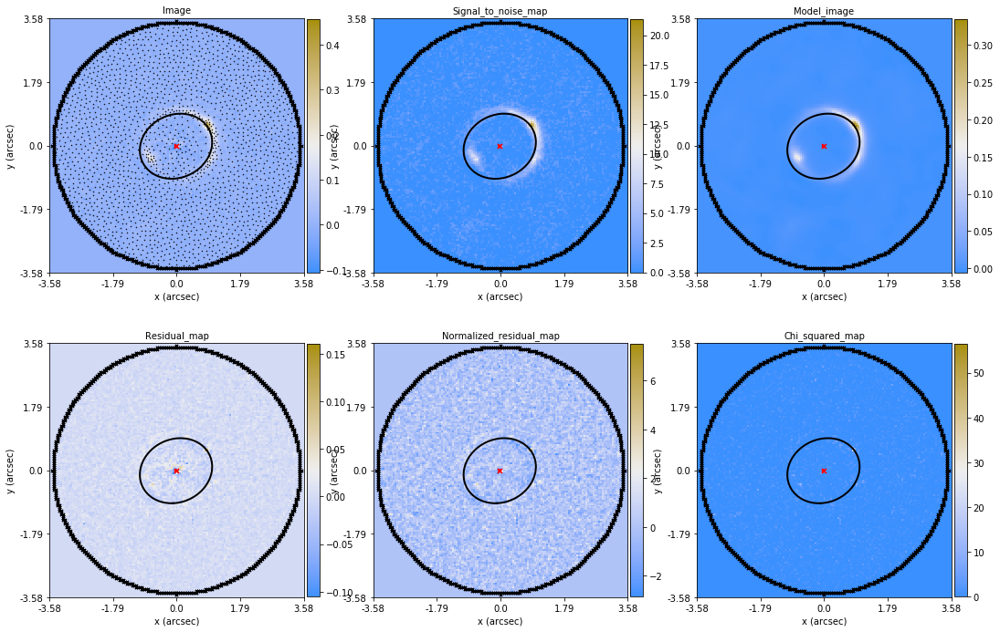

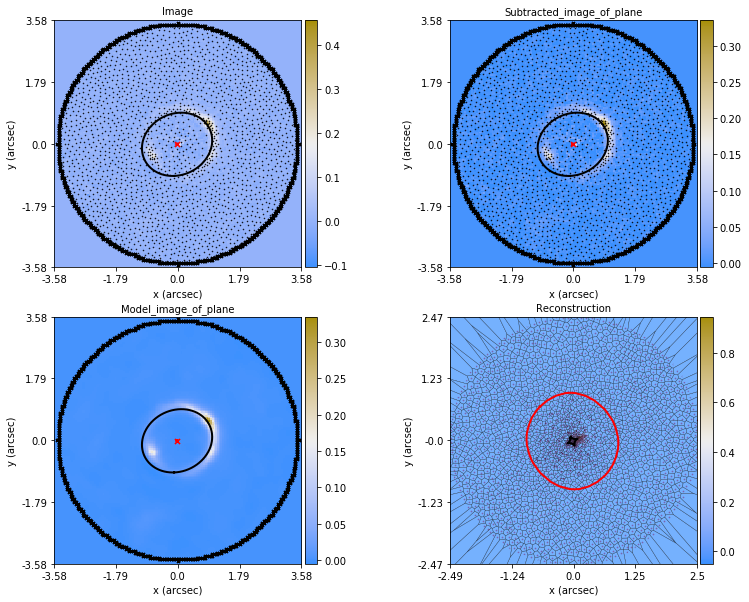

slacs0216-0813


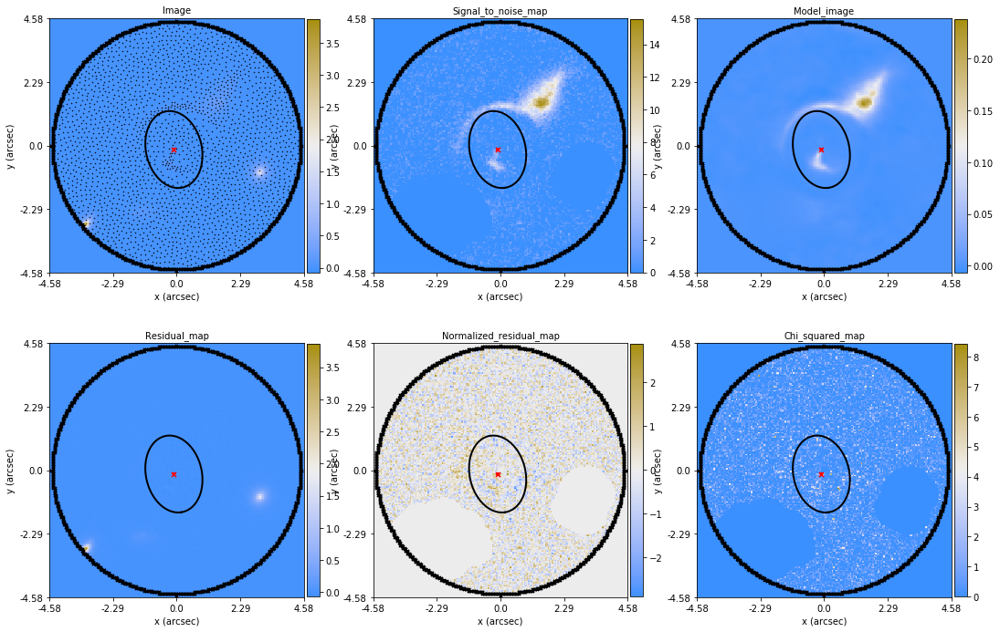

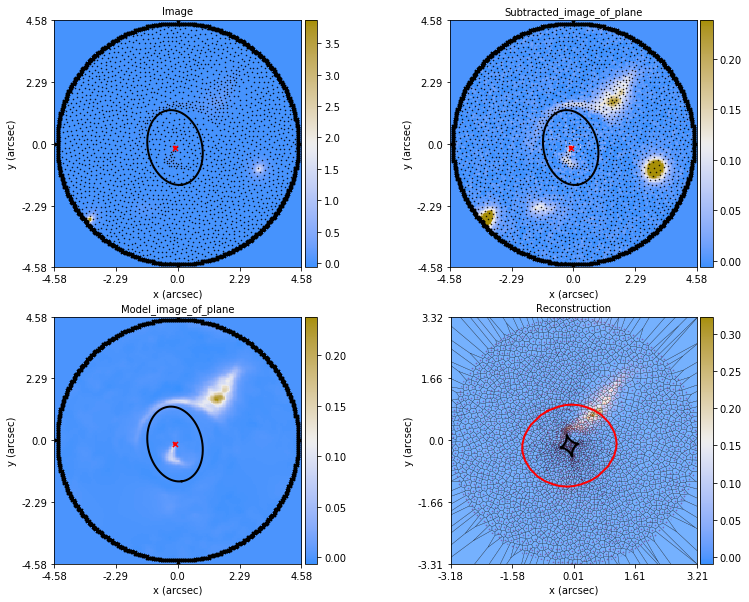

slacs0822+2652


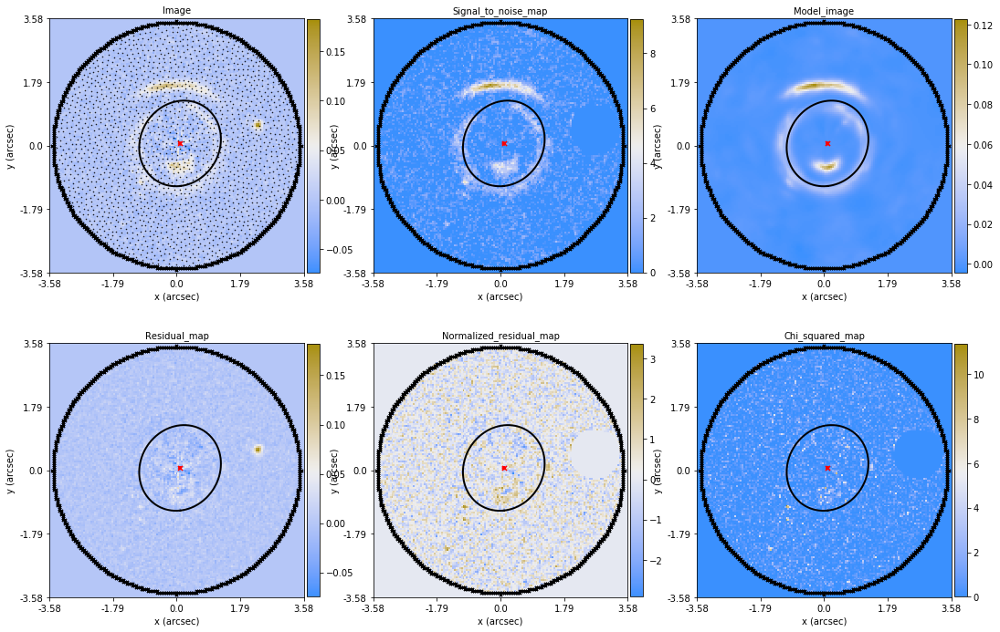

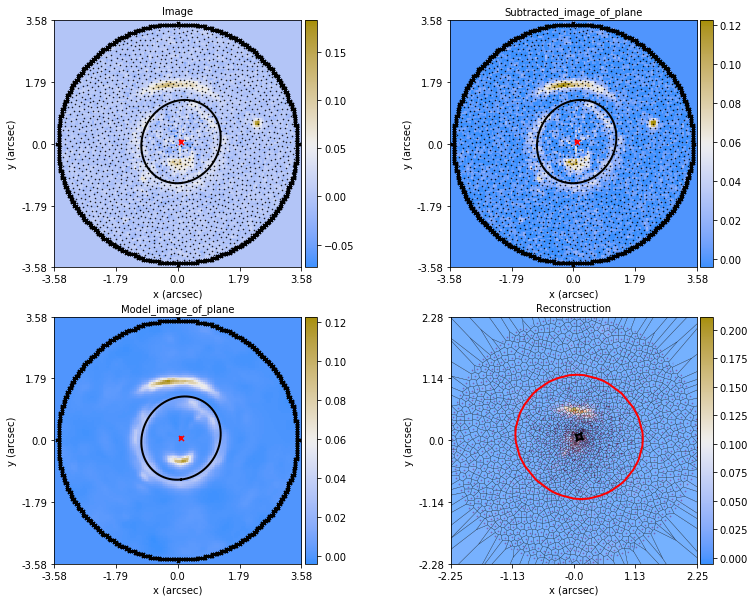

slacs1402+6321


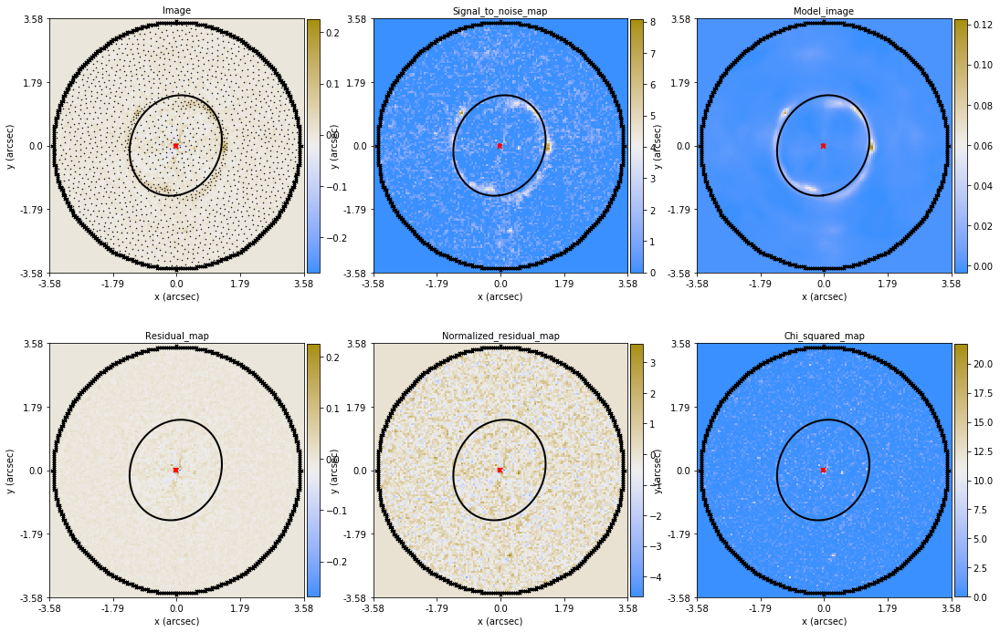

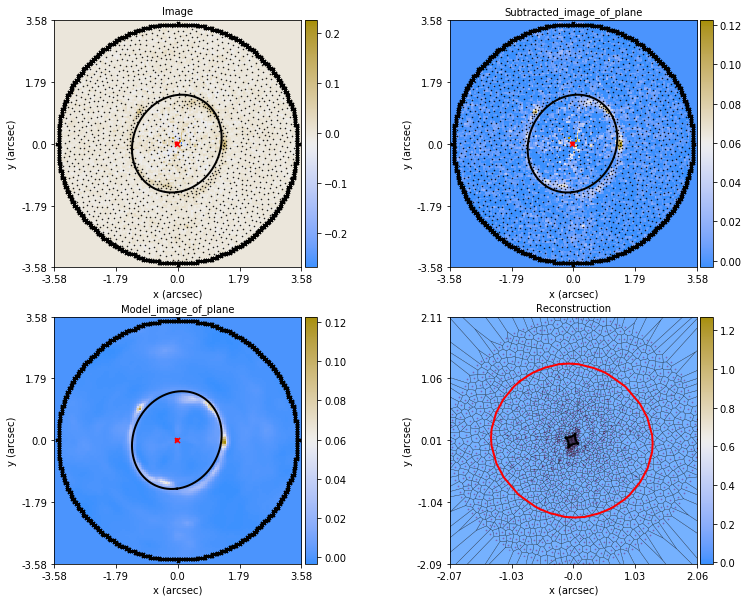

slacs2238-0754


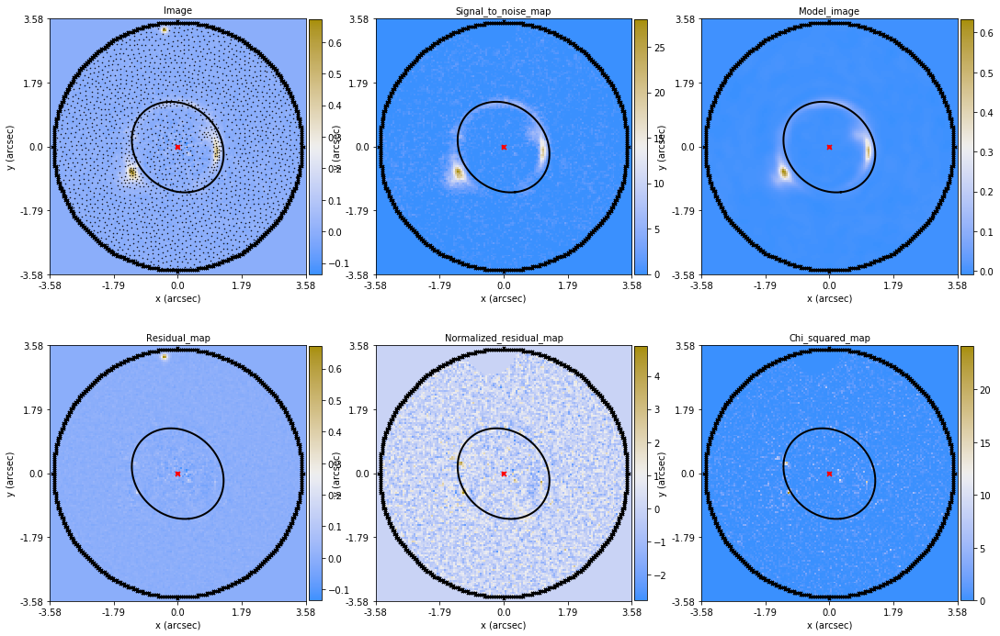

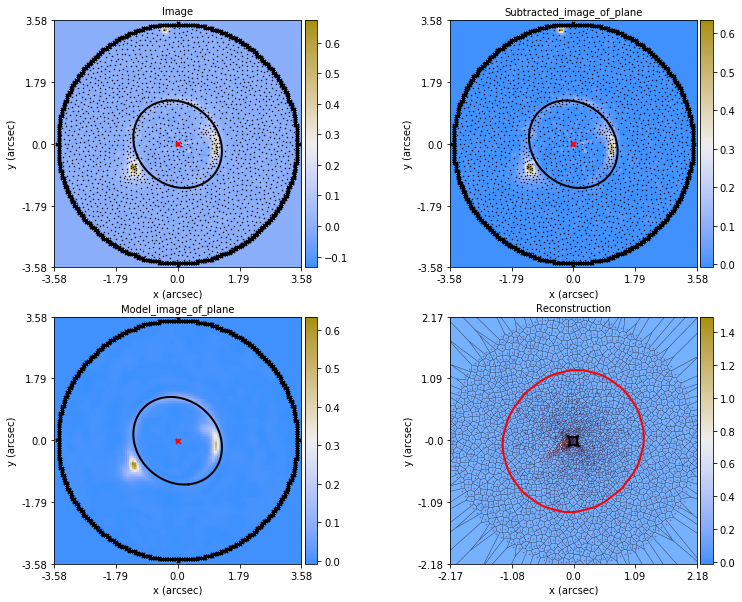

slacs0959+4416


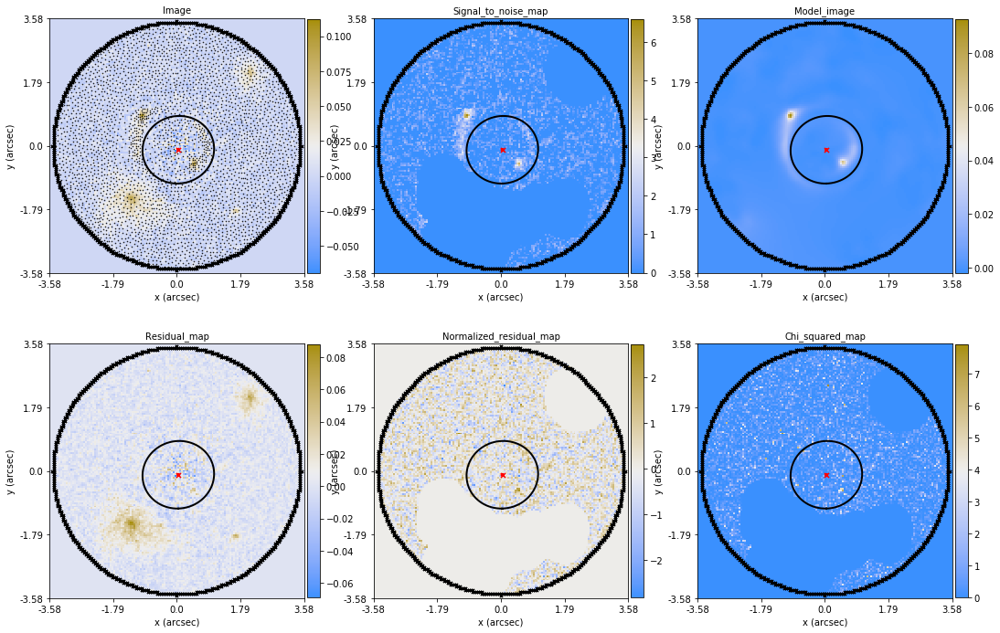

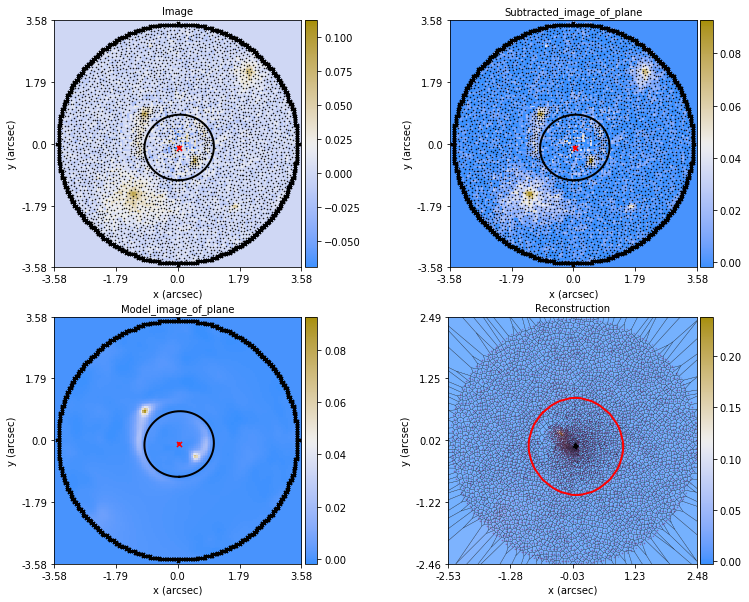

slacs0959+0410


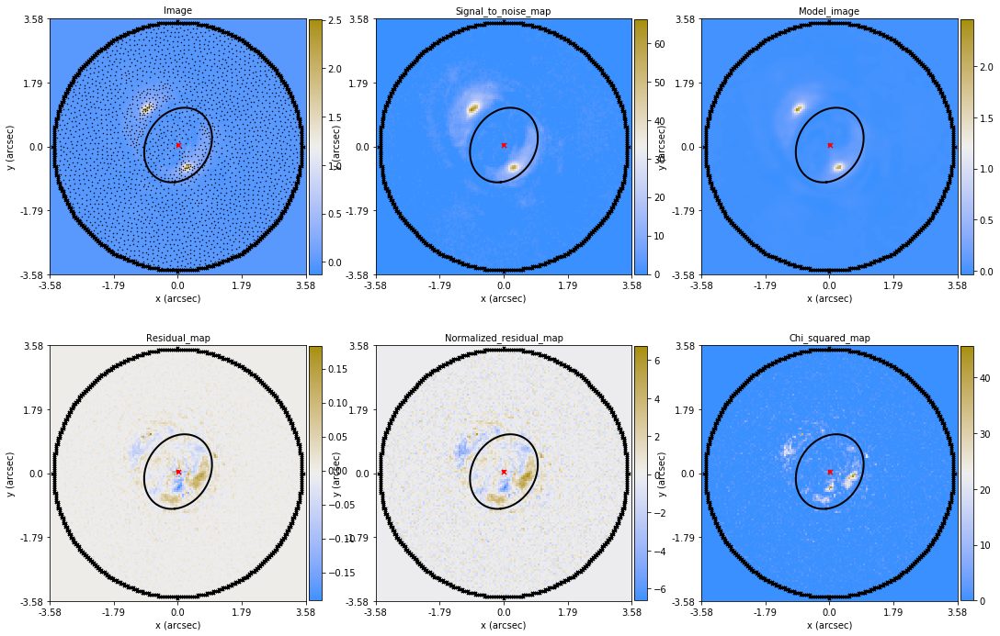

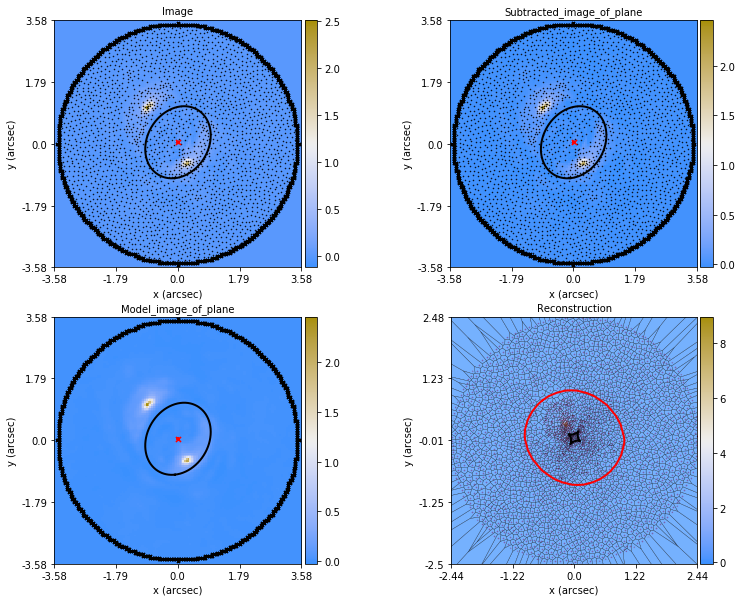

slacs2341+0000


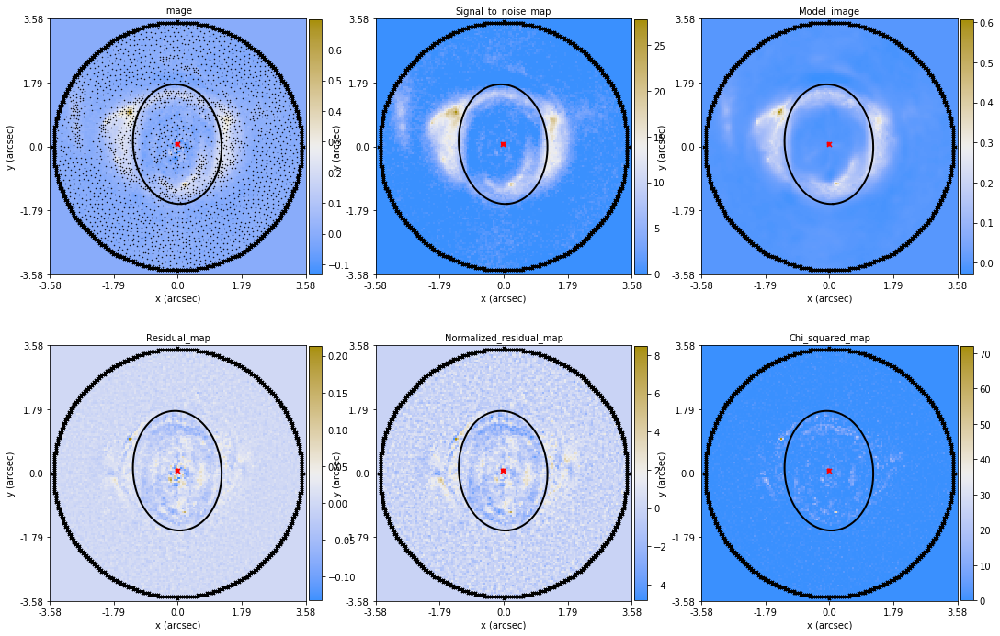

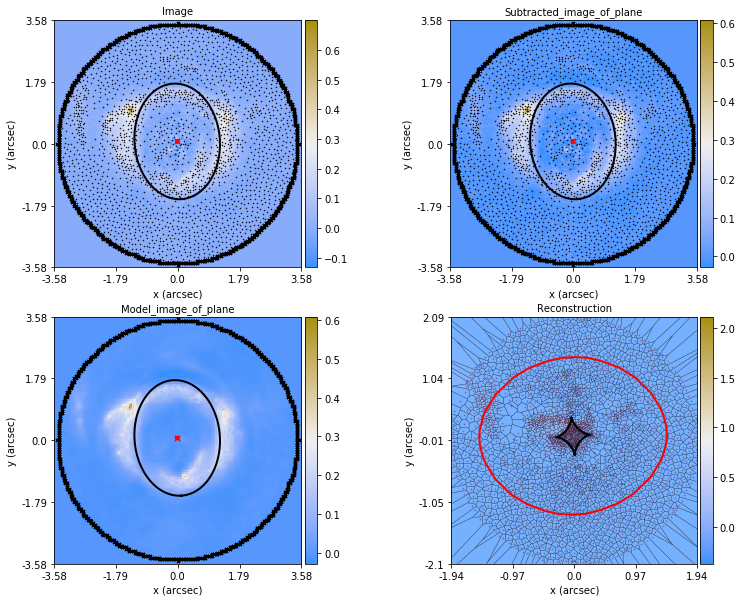

slacs1016+3859


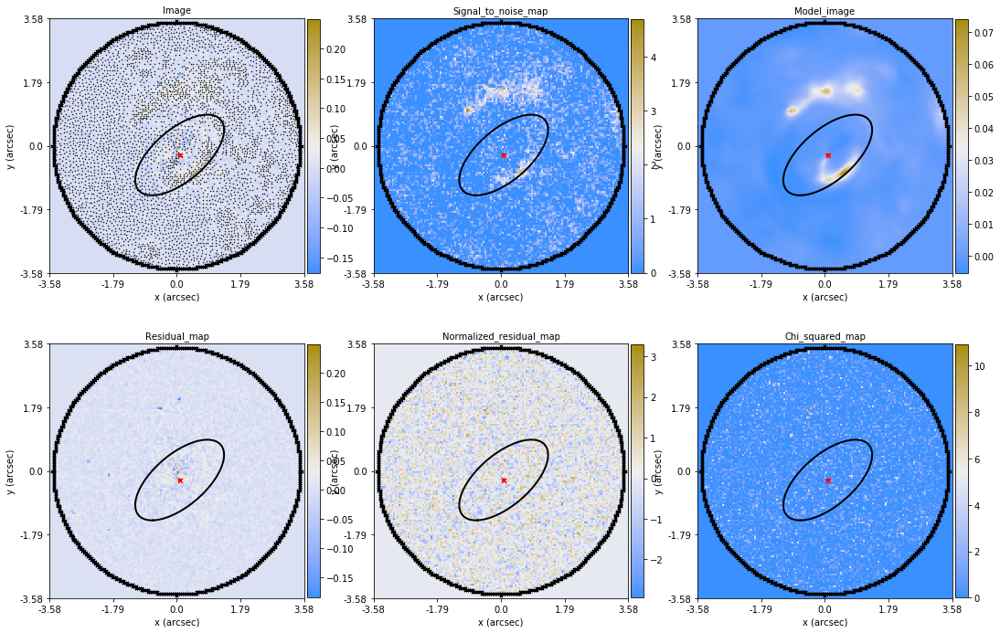

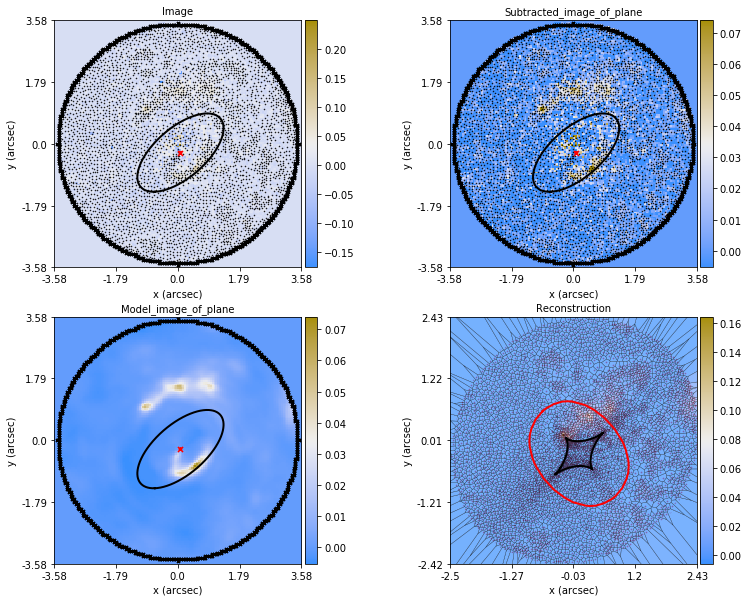

slacs0936+0913


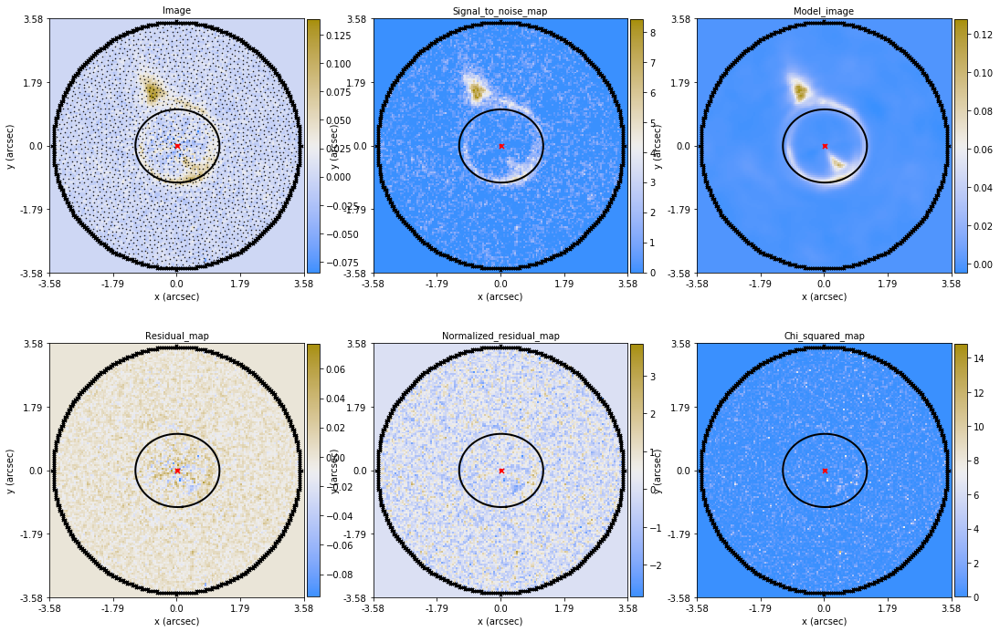

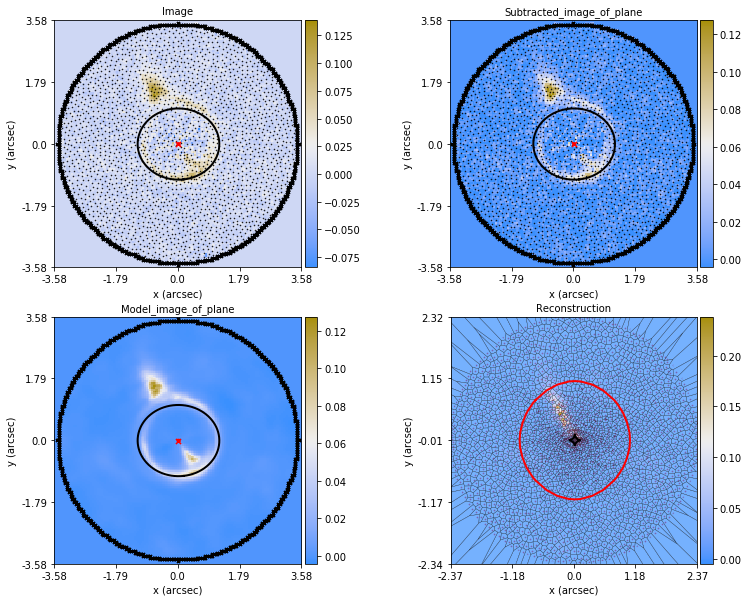

slacs1250+0523


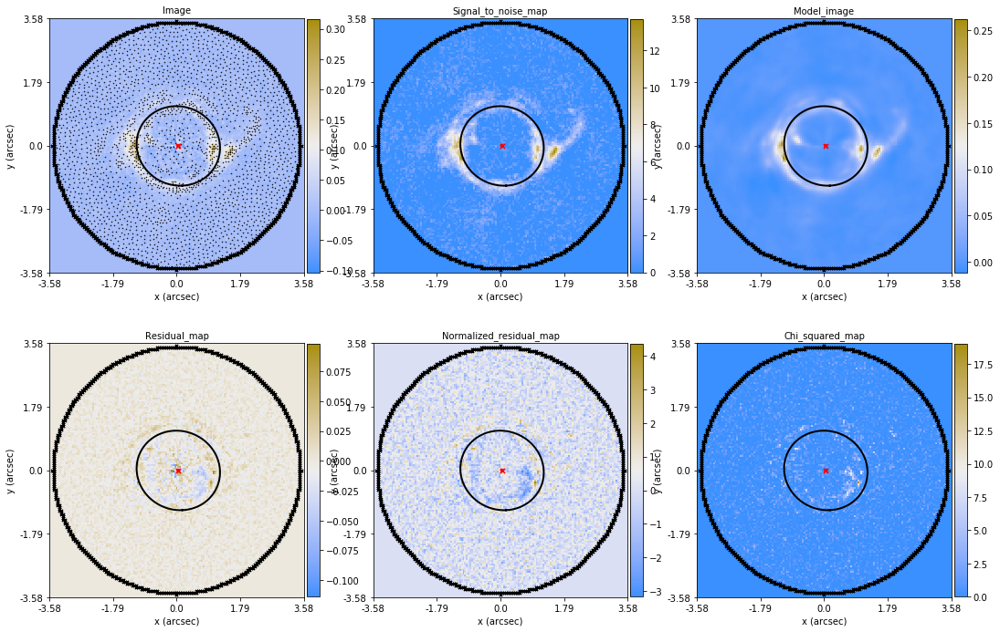

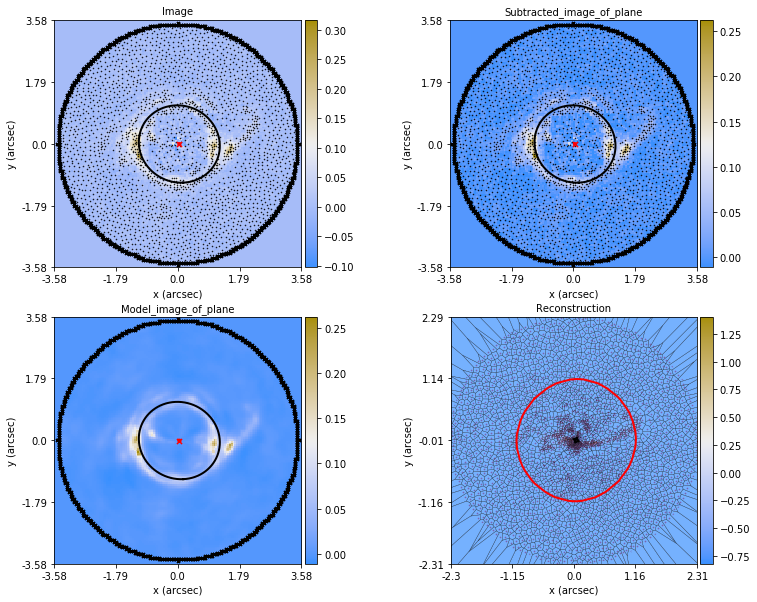

slacs1153+4612


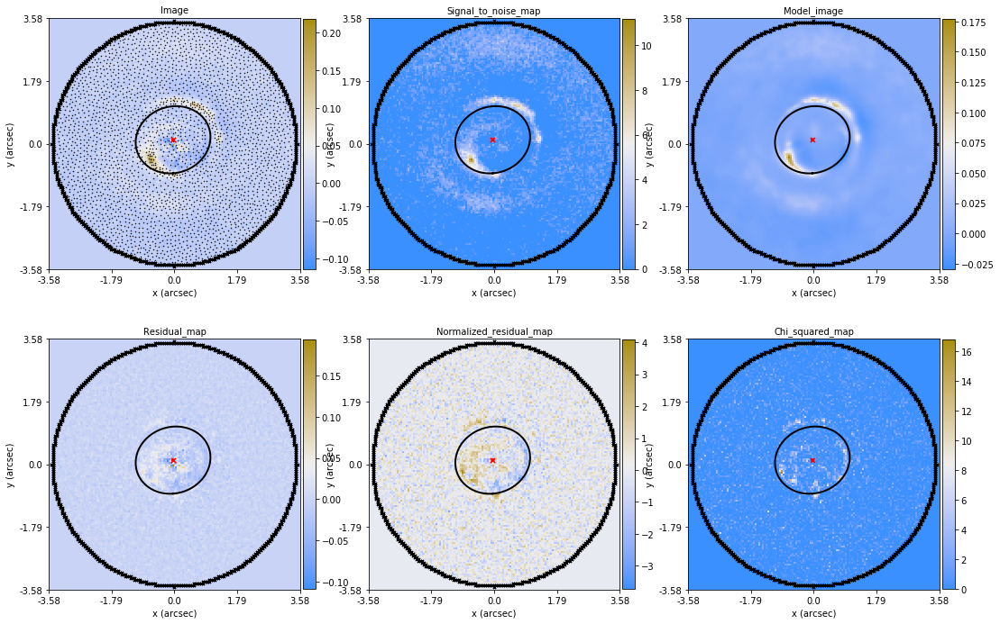

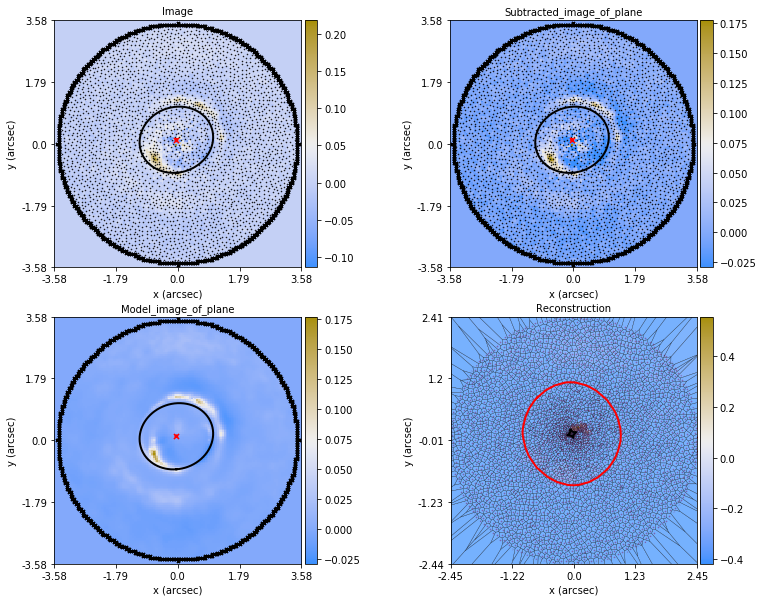

In [13]:
fit_gen = al.agg.FitImaging(
        aggregator=agg_sie_cap
    )

for fit in fit_gen:
    print(fit.name)
    aplt.FitImaging.subplot_fit_imaging(fit=fit)
    aplt.FitImaging.subplot_of_plane(fit=fit, plane_index=1)

In [6]:
datasets = agg_sie.values("dataset")
outputs = agg_sie.values("samples")
info_gen = agg_sie.values("info")
info_no_shear =[info for info in info_gen]
instances = [samps.median_pdf_instance for samps in agg_sie.values("samples")]

sigma_crits = [cosmology_util.critical_surface_density_between_redshifts_from(
        redshift_0=info['redshift_lens'], redshift_1=info['redshift_source'], cosmology=cosmo
        ) for info in info_no_shear]

M_Ein_SLACS = np.array([np.pi*sigma_crit*info['r_ein']**2 for info, sigma_crit in zip(info_no_shear, sigma_crits)])

M_Ein = np.array([instance.galaxies.lens.einstein_mass_angular_via_tangential_critical_curve*sigma for 
                  instance, sigma in zip(instances, sigma_crits)])

R_Ein_frac = [(instance.galaxies.lens.einstein_radius_via_tangential_critical_curve - info['r_ein'])/info['r_ein']
              for info, instance in zip(info_no_shear, instances)]

M_Ein_frac = (M_Ein - M_Ein_SLACS)/M_Ein_SLACS

q_diff = [instance.galaxies.lens.mass.axis_ratio - info['axis_ratio'] for instance, info in zip(instances, info_no_shear)]


PA = [instance.galaxies.lens.mass.phi+180 if instance.galaxies.lens.mass.phi<0 
      else instance.galaxies.lens.mass.phi for instance in instances]

PA_diff = [p - info['position_angle'] for p, info in zip(PA, info_no_shear)]

centre_diff = [np.sqrt(instance.galaxies.lens.mass.centre[0]**2)+np.abs(instance.galaxies.lens.mass.centre[1]**2) for instance in instances]


In [7]:
R_Ein = [instance.galaxies.lens.einstein_radius_via_tangential_critical_curve 
              for instance in instances]

In [8]:
print('RMS frac diff Einstein mass', np.sqrt(np.mean(np.square(M_Ein_frac))))
print('RMS frac diff Einstein radius', np.sqrt(np.mean(np.square(R_Ein_frac))))
print("RMS q diff", np.sqrt(np.mean(np.square(q_diff))))
print("RMS phi diff", np.sqrt(np.mean(np.square(PA_diff))))

RMS frac diff Einstein mass 0.13495913655922134
RMS frac diff Einstein radius 0.09010843100571807
RMS q diff 0.17429322084924043
RMS phi diff 10.73665125434019


In [9]:
M_Ein_frac_no_out = []
R_Ein_frac_no_out = []
q_no_out = []
phi_no_out = []

for i, dataset in zip(range(len(M_Ein_frac)), agg_sie.values("dataset")):
    if dataset.name not in ["slacs1451-0239"]:
        M_Ein_frac_no_out.append(M_Ein_frac[i])
        R_Ein_frac_no_out.append(R_Ein_frac[i])
        q_no_out.append(q_diff[i])
        phi_no_out.append(PA_diff[i])
    else: 
        pass
    
print('RMS frac diff Einstein mass', np.sqrt(np.mean(np.square(M_Ein_frac_no_out))))
print('RMS frac diff Einstein radius', np.sqrt(np.mean(np.square(R_Ein_frac_no_out))))
print("RMS q diff", np.sqrt(np.mean(np.square(q_no_out))))
print("RMS phi diff", np.sqrt(np.mean(np.square(phi_no_out))))

RMS frac diff Einstein mass 0.03785277722766199
RMS frac diff Einstein radius 0.01885733532188733
RMS q diff 0.08287802857663824
RMS phi diff 10.098733109569539


In [127]:
print(len(M_Ein_frac_no_out))

34


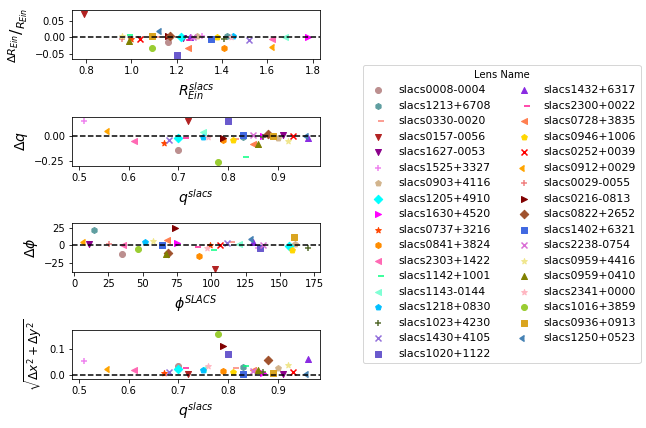

In [19]:
datasets = agg_sie.values("dataset")
outputs = agg_sie.values("samples")
info_gen = agg_sie.values("info")
info_no_shear =[info for info in info_gen]
instances = [samps.median_pdf_instance for samps in agg_sie.values("samples")]

fig1, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(9,6))
for i, info, dataset in zip(range(len(info_no_shear)), info_no_shear, datasets):
    if dataset.name not in ["slacs1451-0239"]:
        ax1.scatter(info['r_ein'], R_Ein_frac[i], color=info['colour'],
                marker=info['marker'], label=dataset.name)
        ax2.scatter(info['axis_ratio'], q_diff[i], color=info['colour'],
                marker=info['marker'])
        ax3.scatter(info['position_angle'], PA_diff[i], color=info['colour'],
                marker=info['marker'])
        ax4.scatter(info['axis_ratio'], centre_diff[i], color=info['colour'],
                marker=info['marker'])
    else:
        pass
ax1.set_ylabel(r'$^{\Delta R_{Ein}}/_{R_{Ein}}$', size=16)
ax1.axhline(y=0, color='k', linestyle='--')    
ax1.set_xlabel(r'$R_{Ein}^{slacs}$', size=14)
ax2.set_xlabel(r'$q^{slacs}$', size=14)
ax2.set_ylabel(r'$\Delta q$', size=14)
ax2.axhline(y=0, color='k', linestyle='--')
ax4.set_ylabel(r'$\sqrt{\Delta x^2 + \Delta y^2}$', size=12)
ax4.axhline(y=0, color='k', linestyle='--')
ax4.set_xlabel(r'$q^{slacs}$', size=14)
ax3.set_ylabel(r'$\Delta \phi$', size=14)
ax3.axhline(y=0, color='k', linestyle='--')
ax3.set_xlabel(r'$\phi^{SLACS}$', size=14)
legend = fig1.legend(loc='center right', title= 'Lens Name', ncol=2, fontsize=11)
plt.tight_layout()
plt.subplots_adjust(right=0.5)
plt.savefig(fig_path + 'sie_param_slacs_comparison', bbox_inches='tight', dpi=300, transparent=True)

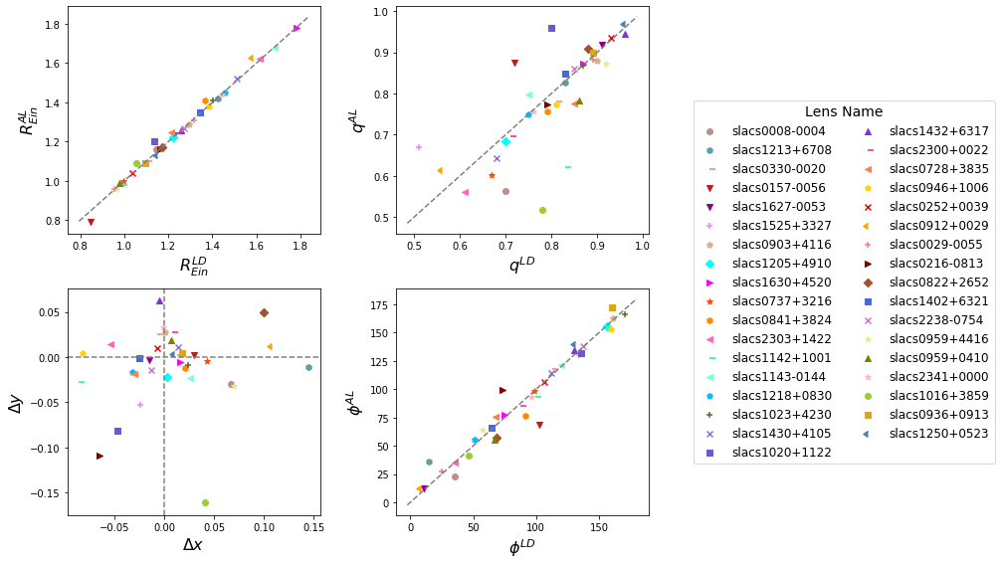

In [131]:
datasets = agg_sie.values("dataset")
outputs = agg_sie.values("samples")
info_gen = agg_sie.values("info")
info_no_shear =[info for info in info_gen]
instances = [samps.median_pdf_instance for samps in agg_sie.values("samples")]

fig1, ax = plt.subplots(2, 2, figsize=(14,8))
for instance, info, dataset, r in zip(instances, info_no_shear, datasets, R_Ein):
    if dataset.name not in ["slacs1451-0239"]:
        ax[0,0].scatter(r, info["r_ein"], color=info['colour'],
                marker=info['marker'])
        ax[0,1].scatter(info["axis_ratio"], instance.galaxies.lens.mass.axis_ratio, color=info['colour'],
                marker=info['marker'])
        ax[1,0].scatter(instance.galaxies.lens.mass.centre[1], instance.galaxies.lens.mass.centre[0], color=info['colour'],
                marker=info['marker'])
        if instance.galaxies.lens.mass.phi<0:
            ax[1,1].scatter(info["position_angle"],instance.galaxies.lens.mass.phi+180, color=info['colour'],
                marker=info['marker'], label=dataset.name,)
        else:   
            ax[1,1].scatter(info["position_angle"],instance.galaxies.lens.mass.phi, color=info['colour'],
                marker=info['marker'], label=dataset.name,)
    else:
        pass
ax[0,0].set_ylabel(r'$R_{Ein}^{AL}$', size=16)
ax[0,0].set_xlabel(r'$R_{Ein}^{LD}$', size=16)
x = np.linspace(*ax[0,0].get_xlim())
ax[0,0].plot(x, x, ls="--", color="gray")
ax[0,1].set_ylabel(r'$q^{AL}$', size=16)
ax[0,1].set_xlabel(r'$q^{LD}$', size=16)
x = np.linspace(*ax[0,1].get_xlim())
ax[0,1].plot(x, x, ls="--", color="gray")
ax[1,0].set_xlabel(r'$\Delta x$', size=16)
ax[1,0].set_ylabel(r'$\Delta y$', size=16)
ax[1,0].axhline(y=0, ls="--", color="gray")
ax[1,0].axvline(x=0, ls="--", color="gray")
ax[1,1].set_ylabel(r'$\phi^{AL}$', size=16)
ax[1,1].set_xlabel(r'$\phi^{LD}$', size=16)
x = np.linspace(*ax[1,1].get_xlim())
ax[1,1].plot(x, x, ls="--", color="gray")
legend = fig1.legend(loc='center right', title= 'Lens Name', ncol=2, fontsize=12)
legend.get_title().set_fontsize('14')
plt.tight_layout()
plt.subplots_adjust(right=0.65, wspace=0.3)
plt.savefig(fig_path + 'SLACS_SIE_comp_squares', bbox_inches='tight', dpi=300, transparent=True)

In [ ]:
fit_gen = al.agg.FitImaging(aggregator=agg_no_shear_sie)

for fit, dataset in zip(fit_gen, agg_no_shear_sie.values("dataset")):
    if dataset.name in no_shear_outlier:
        print(dataset.name)
        aplt.FitImaging.subplot_fit_imaging(fit=fit)
        aplt.FitImaging.subplot_of_plane(fit=fit, plane_index=1)

In [ ]:
datasets_shear = agg_shear_sie.values("dataset")
outputs_shear = agg_shear_sie.values("samples")
info_gen_shear = agg_shear_sie.values("info")
info_shear =[info for info in info_gen_shear]
instances_shear = [samps.median_pdf_instance for samps in agg_shear_sie.values("samples")]

sigma_crits_shear = [cosmology_util.critical_surface_density_between_redshifts_from(
        redshift_0=info['redshift_lens'], redshift_1=info['redshift_source'], cosmology=cosmo, unit_mass='solMass'
        ) for info in info_shear]

M_Ein_SLACS_shear = np.array([np.pi*sigma_crit*info['r_ein']**2 for info, sigma_crit in zip(info_shear, sigma_crits_shear)])

M_Ein_shear = np.array([instance.galaxies.lens.einstein_mass_in_units(
            redshift_object=info['redshift_lens'],
            redshift_source=info['redshift_source']
                      ) for instance, info in zip(instances_shear, info_shear)])

R_Ein_frac_shear = [(instance.galaxies.lens.einstein_radius_in_units(
                       unit_length='arcsec') - info['r_ein'])/info['r_ein']
              for info, instance in zip(info_shear, instances_shear)]

M_Ein_frac_shear = (M_Ein_shear - M_Ein_SLACS_shear)/M_Ein_SLACS_shear

q_diff_shear = [instance.galaxies.lens.mass.axis_ratio - info['axis_ratio'] for instance, info in zip(instances_shear, info_shear)]

PA_diff_shear = [90-np.abs(np.abs(instance.galaxies.lens.mass.phi - info['position_angle'])-90) for instance, info in zip(instances_shear, info_shear)]

centre_diff_shear = [np.sqrt(instance.galaxies.lens.mass.centre[0]**2)+np.abs(instance.galaxies.lens.mass.centre[1]**2) for instance in instances_shear]


In [ ]:
print('RMS frac diff Einstein mass', np.sqrt(np.mean(np.square(M_Ein_frac_shear))))
print("RMS q diff", np.sqrt(np.mean(np.square(q_diff_shear))))
print("RMS phi diff", np.sqrt(np.mean(np.square(PA_diff_shear))))

In [ ]:
M_Ein_no_out_shear = [i for i in M_Ein_frac_shear if np.abs(i) <= 0.1]
print(np.sqrt(np.mean(np.square(M_Ein_no_out_shear))))

In [ ]:
M_Ein_frac_no_out_shear = []
q_no_out_shear = []
phi_no_out_shear = []

for i, dataset in zip(range(len(M_Ein_frac_shear)), agg_shear_sie.values("dataset")):
    if dataset.name not in ["slacs0157-0056", "slacs0956+5100","slacs1029+0420", "slacs1420+6019", "slacs1103+5322", "slacs1032+5322", "slacs1153+4612", "slacs1416+5136"]:
        M_Ein_frac_no_out_shear.append(M_Ein_frac_shear[i])
        q_no_out_shear.append(q_diff_shear[i])
        phi_no_out_shear.append(PA_diff_shear[i])
    else: 
        pass
    
print('RMS frac diff Einstein mass', np.sqrt(np.mean(np.square(M_Ein_frac_no_out_shear))))
print("RMS q diff", np.sqrt(np.mean(np.square(q_no_out_shear))))
print("RMS phi diff", np.sqrt(np.mean(np.square(phi_no_out_shear))))

In [ ]:
fig2, (ax1, ax2, ax3, ax4, ax5) = plt.subplots(5, 1, sharex=True, figsize=(10,6))
for i, info, dataset in zip(range(len(info_shear)), info_shear, agg_shear_sie.values("dataset")):
    if dataset.name not in ["slacs0956+5100","slacs1029+0420", "slacs1420+6019", "slacs1103+5322", "slacs1032+5322", "slacs1153+4612", "slacs1416+5136"]:
        ax1.scatter(info['axis_ratio'], M_Ein_frac_shear[i],
                c=info['colour'], label=dataset.name, marker=info['marker'])
        ax2.scatter(info['axis_ratio'], R_Ein_frac_shear[i], color=info['colour'],
                marker=info['marker'])
        ax3.scatter(info['axis_ratio'], centre_diff_shear[i], color=info['colour'],
                marker=info['marker'])
        ax4.scatter(info['axis_ratio'], q_diff_shear[i], color=info['colour'],
                marker=info['marker'])
        ax5.scatter(info['axis_ratio'], PA_diff_shear[i], color=info['colour'],
                marker=info['marker'])
ax1.set_ylabel(r'$\frac{\Delta M_{Ein}}{M_{Ein}}$', size=16)
ax1.axhline(y=0, color='k', linestyle='--')
ax2.set_ylabel(r'$\frac{\Delta R_{Ein}}{R_{Ein}}$', size=16)
ax2.axhline(y=0, color='k', linestyle='--')                                
ax4.set_ylabel(r'$\Delta q$', size=14)
ax4.axhline(y=0, color='k', linestyle='--')
ax3.set_ylabel(r'$\sqrt{\Delta x^2 + \Delta y^2}$', size=12)
ax3.axhline(y=0, color='k', linestyle='--')
ax5.set_ylabel(r'$|\Delta \phi|$', size=14)
ax5.axhline(y=3.8, color='k', linestyle='--')
ax5.set_xlabel(r'$q^{SLACS}$', size=14)
legend = fig2.legend(loc='center right', title= 'Lens Name', ncol=2, fontsize=10)
plt.tight_layout()
plt.subplots_adjust(right=0.6)
plt.savefig(fig_path + 'sie_param_slacs_comparison_shear', bbox_inches='tight', dpi=300)

In [ ]:
fit_gen = al.agg.FitImaging(aggregator=agg_shear_sie)

for fit in fit_gen:
    if fit.name in shear_outlier:
        print(fit.name)
        aplt.FitImaging.subplot_fit_imaging(fit=fit)
        aplt.FitImaging.subplot_of_plane(fit=fit, plane_index=1)